## Project Data Science - Cahya Mega Panji Santosa

# Customer Personality Analysis using Machine Learning (Unsupervised Learning - Clustering)

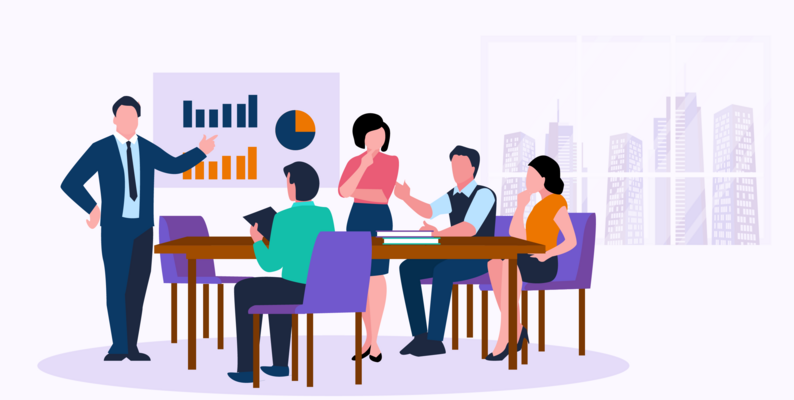

Memahami kebutuhan pelanggan adalah poin penting dalam bisnis. Kebutuhan pelanggan akan terus berubah dan untuk kelompok pelanggan tertentu akan ada kebutuhan yang berbeda. Karena kebutuhan dan jenis pelanggan yang berbeda, penting bagi perusahaan untuk menguasai kelompok pelanggan mereka yang berbeda.

## Data Cleaning & Preprocessing

### Import Library & File

In [1]:
# Import Library

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
import warnings

import matplotlib.dates as mdates
import plotly.express as px

from sklearn.preprocessing import LabelEncoder
from sklearn import preprocessing

pd.set_option('display.max_columns', 50)                                        # show max 50 column
warnings.filterwarnings('ignore')                                               # ignore the warning

In [2]:
# Import File

df = pd.read_csv('/Users/mcbookair/Desktop/Final Project Bootcamp/marketing_campaign_before_scaling.csv', sep="\t")                            # uniques separator copy from excel (\t = tab)
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0


**Detail** : Data diambil dari Tahun 2012 - 2015 dihimpun oleh Dr. Omar Romero-Hernandez (Source : https://www.kaggle.com/datasets/imakash3011/customer-personality-analysis), Data ini merupakan behaviour customer dalam berbelanja di toko.

In [3]:
# Data information

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [4]:
df.shape

(2240, 29)

**Detail** : Table terdiri dari 29 Column dan Terdapat Null pada Column Income

In [5]:
#Data grouping

categorical_cols = ['Education','Marital_Status','Complain','AcceptedCmp1','AcceptedCmp2',
            'AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','Response']

date_cols = ['Year_Birth','Dt_Customer']

numerical_cols = ['Income','Kidhome','Teenhome','Recency','MntWines','MntFruits','MntMeatProducts','MntFishProducts',
            'MntSweetProducts','MntGoldProds','NumDealsPurchases','NumWebPurchases','NumCatalogPurchases',
            'NumStorePurchases','NumWebVisitsMonth']

**Detail** : Data grouping based on kolom tipe Categorical, Date, Numerical

### Handling Missing & Duplicate Values

In [6]:
# Mengecek Null & Unique

def summary_table(df): #function to create an added information regarding the dataset
    summary = pd.DataFrame(dict(dataFeatures = df.columns,
                                  dataType = df.dtypes, #display datatype
                                  null = df.isna().sum(), #sum of null values
                                  null_percentage = round(df.isna().sum() / len(df) *100,2),#how many percente null values
                                  unique = df.nunique(),  #cek for number of unique values
                                  uniqueData = [list(df[i].unique()) for i in df.columns] #unique value
                               )
                           ).reset_index(drop=True)
    summary['unique_percentage'] = round(summary['unique'] / len(df) *100,2) #convert unique to percentage values
    return summary

In [7]:
summary_table(df)

,dataFeatures,dataType,null,null_percentage,unique,uniqueData,unique_percentage
0,ID,int64,0,0.00,2240,"[5524, 2174, 4141, 6182, 5324, 7446, 965, 6177...",100.00
1,Year_Birth,int64,0,0.00,59,"[1957, 1954, 1965, 1984, 1981, 1967, 1971, 198...",2.63
2,Education,object,0,0.00,5,"[Graduation, PhD, Master, Basic, 2n Cycle]",0.22
3,Marital_Status,object,0,0.00,8,"[Single, Together, Married, Divorced, Widow, A...",0.36
4,Income,float64,24,1.07,1974,"[58138.0, 46344.0, 71613.0, 26646.0, 58293.0, ...",88.12
5,Kidhome,int64,0,0.00,3,"[0, 1, 2]",0.13
6,Teenhome,int64,0,0.00,3,"[0, 1, 2]",0.13
7,Dt_Customer,object,0,0.00,663,"[04-09-2012, 08-03-2014, 21-08-2013, 10-02-201...",29.60
8,Recency,int64,0,0.00,100,"[58, 38, 26, 94, 16, 34, 32, 19, 68, 11, 59, 8...",4.46
9,MntWines,int64,0,0.00,776,"[635, 11, 426, 173, 520, 235, 76, 14, 28, 5, 6...",34.64


**Detail** : Terdapat Null pada Column Income sejumlah 24. Detail terlampir pada table berikut ini.

In [8]:
# ID dengan Income Null

df_null = df[df['Income'].isna()]
null_id = list(df_null["ID"])
null_id

[1994,
 5255,
 7281,
 7244,
 8557,
 10629,
 8996,
 9235,
 5798,
 8268,
 1295,
 2437,
 2863,
 10475,
 2902,
 4345,
 3769,
 7187,
 1612,
 5079,
 10339,
 3117,
 5250,
 8720]

In [9]:
# Data dengan Income NaN

df.loc[df['ID'].isin(null_id)]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
10,1994,1983,Graduation,Married,NaN,1,0,15-11-2013,11,5,5,6,0,2,1,1,1,0,2,7,0,0,0,0,0,0,3,11,0
27,5255,1986,Graduation,Single,NaN,1,0,20-02-2013,19,5,1,3,3,263,362,0,27,0,0,1,0,0,0,0,0,0,3,11,0
43,7281,1959,PhD,Single,NaN,0,0,05-11-2013,80,81,11,50,3,2,39,1,1,3,4,2,0,0,0,0,0,0,3,11,0
48,7244,1951,Graduation,Single,NaN,2,1,01-01-2014,96,48,5,48,6,10,7,3,2,1,4,6,0,0,0,0,0,0,3,11,0
58,8557,1982,Graduation,Single,NaN,1,0,17-06-2013,57,11,3,22,2,2,6,2,2,0,3,6,0,0,0,0,0,0,3,11,0
71,10629,1973,2n Cycle,Married,NaN,1,0,14-09-2012,25,25,3,43,17,4,17,3,3,0,3,8,0,0,0,0,0,0,3,11,0
90,8996,1957,PhD,Married,NaN,2,1,19-11-2012,4,230,42,192,49,37,53,12,7,2,8,9,0,0,0,0,0,0,3,11,0
91,9235,1957,Graduation,Single,NaN,1,1,27-05-2014,45,7,0,8,2,0,1,1,1,0,2,7,0,0,0,0,0,0,3,11,0
92,5798,1973,Master,Together,NaN,0,0,23-11-2013,87,445,37,359,98,28,18,1,2,4,8,1,0,0,0,0,0,0,3,11,0
128,8268,1961,PhD,Married,NaN,0,1,11-07-2013,23,352,0,27,10,0,15,3,6,1,7,6,0,0,0,0,0,0,3,11,0


In [10]:
# Modus pada data tersebut adalah 7500 sebanyak 12 data, dengan persentase sebesar : 

Modus = (12/len(df['Income'])*100)
print("Persentase Modus adalah:", Modus)

Persentase Modus adalah: 0.5357142857142857


In [11]:
# Jumlah Customer per-Income

df_inc = pd.DataFrame(df['Income'].value_counts())
df_inc = df_inc.reset_index().rename(columns = {'index' : 'Income','Income' : 'Value Count'})

px.scatter(df_inc, x=df_inc['Income'], y=df_inc['Value Count'])

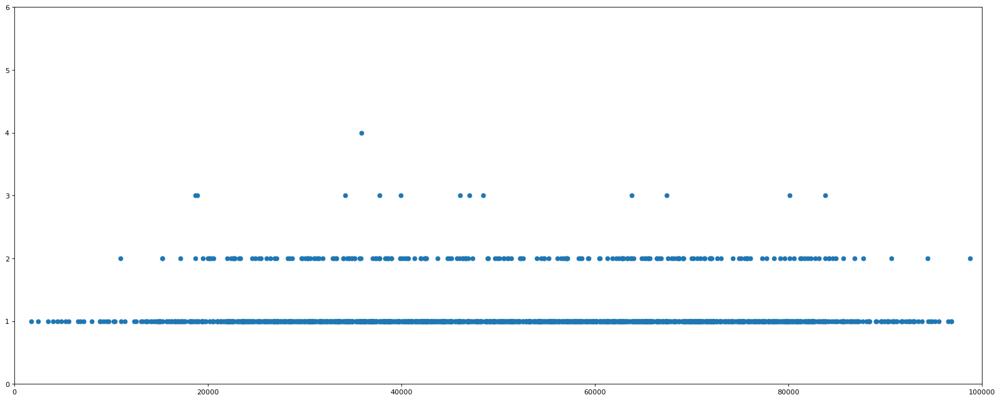

In [12]:
# Jumlah Customer per-Income

plt.figure(figsize=(25, 10), dpi=80)
plt.scatter(df_inc['Income'],df_inc['Value Count'], cmap="viridis")
plt.xlim([0, 100000])                                                           # Editable
plt.ylim([0, 6])                                                                # Editable
plt.show()

<AxesSubplot:xlabel='Income'>

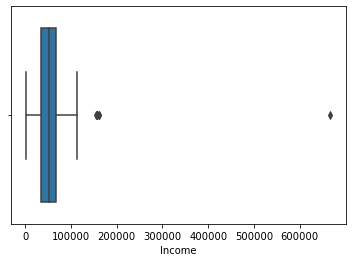

In [13]:
# Check Outlier to fill Null

sns.boxplot(df.Income)

In [14]:
# Skewness Normal nilai antara -1 s/d 1, normal dengan mean & tidak normal dengan median

df1 = ["Income"]
df[df1].skew(axis=0, skipna=True)

Income    6.763487
dtype: float64

**Detail** : Dari pengecekan income diatas, didapatkan 

1.   Modus adalah 7500 sebanyak 12 Customer dengan jumlah lainnya berkisar antara 4-1 Customer, Sehingga dapat digunakan modus sebagai handling null.
2.   Kemudian jika dicek kembali dengan persebaran pada "Jumlah Customer per-Income", didapatkan persebaran banyak data diantara 17000 - 84000.
3.   Dari pengecekan outlier, terdapat outlier pada data income
4.   Dari pengecekan skewness berada pada 6.8 sehingga tidak normal

Dimana hal tersebut membuat kami lebih memilih menggunakan median sebagai handling null

In [15]:
# Mengisi nilai kosong pada kolom Income dengan nilai Median

df["Income"].fillna(df["Income"].median(), inplace=True)

In [16]:
# Data Information

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2240 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

In [17]:
# Hasil Handling Null

df.loc[df['ID'].isin(null_id)]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
10,1994,1983,Graduation,Married,51381.5,1,0,15-11-2013,11,5,5,6,0,2,1,1,1,0,2,7,0,0,0,0,0,0,3,11,0
27,5255,1986,Graduation,Single,51381.5,1,0,20-02-2013,19,5,1,3,3,263,362,0,27,0,0,1,0,0,0,0,0,0,3,11,0
43,7281,1959,PhD,Single,51381.5,0,0,05-11-2013,80,81,11,50,3,2,39,1,1,3,4,2,0,0,0,0,0,0,3,11,0
48,7244,1951,Graduation,Single,51381.5,2,1,01-01-2014,96,48,5,48,6,10,7,3,2,1,4,6,0,0,0,0,0,0,3,11,0
58,8557,1982,Graduation,Single,51381.5,1,0,17-06-2013,57,11,3,22,2,2,6,2,2,0,3,6,0,0,0,0,0,0,3,11,0
71,10629,1973,2n Cycle,Married,51381.5,1,0,14-09-2012,25,25,3,43,17,4,17,3,3,0,3,8,0,0,0,0,0,0,3,11,0
90,8996,1957,PhD,Married,51381.5,2,1,19-11-2012,4,230,42,192,49,37,53,12,7,2,8,9,0,0,0,0,0,0,3,11,0
91,9235,1957,Graduation,Single,51381.5,1,1,27-05-2014,45,7,0,8,2,0,1,1,1,0,2,7,0,0,0,0,0,0,3,11,0
92,5798,1973,Master,Together,51381.5,0,0,23-11-2013,87,445,37,359,98,28,18,1,2,4,8,1,0,0,0,0,0,0,3,11,0
128,8268,1961,PhD,Married,51381.5,0,1,11-07-2013,23,352,0,27,10,0,15,3,6,1,7,6,0,0,0,0,0,0,3,11,0


**Detail** : Dari data diatas sudah tidak ada Null

In [18]:
# Memeriksa apakah terdapat data yang duplicate

df.duplicated().sum()

0

In [19]:
# Unique data per-column check

df.nunique()

ID                     2240
Year_Birth               59
Education                 5
Marital_Status            8
Income                 1975
Kidhome                   3
Teenhome                  3
Dt_Customer             663
Recency                 100
MntWines                776
MntFruits               158
MntMeatProducts         558
MntFishProducts         182
MntSweetProducts        177
MntGoldProds            213
NumDealsPurchases        15
NumWebPurchases          15
NumCatalogPurchases      14
NumStorePurchases        14
NumWebVisitsMonth        16
AcceptedCmp3              2
AcceptedCmp4              2
AcceptedCmp5              2
AcceptedCmp1              2
AcceptedCmp2              2
Complain                  2
Z_CostContact             1
Z_Revenue                 1
Response                  2
dtype: int64

**Detail** : Dari pengecekan duplicate, tidak ditemukan duplicate. Dan dari pengecekan data unique, perlu dicek kembali kolom dengan tipe categorical data untuk memastikan data-data didalamnya

In [20]:
# Unique values for categorical data

for cat in categorical_cols:
        print(cat, "=", df[cat].unique())

Education = ['Graduation' 'PhD' 'Master' 'Basic' '2n Cycle']
Marital_Status = ['Single' 'Together' 'Married' 'Divorced' 'Widow' 'Alone' 'Absurd' 'YOLO']
Complain = [0 1]
AcceptedCmp1 = [0 1]
AcceptedCmp2 = [0 1]
AcceptedCmp3 = [0 1]
AcceptedCmp4 = [0 1]
AcceptedCmp5 = [0 1]
Response = [1 0]


**Detail** :
Dari pengecekan diatas didapatkan Education :
1.   PhD = Doctoral
2.   Master = Master (no rules)
3.   2n Cycle = Master (with case the previous level must have been achieved)
4.   Graduation = Bachelor
5.   Basic = Non Graduate (Formal School / Course)

dan Marital Status sebagai berikut :
1.   Single = Single
2.   Together = Married
3.   Married = Married
4.   Divorced = Single
5.   Widow = Single
6.   Alone = Single
7.   Absurd = Single
8.   YOLO = Single

Sehingga dilakukan pengelompokan (pada Feature Engineering) sebagai berikut :


1.   Education = [PhD, Master, Graduation, Basic]
2.   List item = [Single, Married]






### EDA

In [21]:
# Statistical Summary

df.describe().T                                                                 # alternatif .transpose()

,count,mean,std,min,25%,50%,75%,max
ID,2240.0,5592.159821,3246.662198,0.0,2828.25,5458.5,8427.75,11191.0
Year_Birth,2240.0,1968.805804,11.984069,1893.0,1959.00,1970.0,1977.00,1996.0
Income,2240.0,52237.975446,25037.955891,1730.0,35538.75,51381.5,68289.75,666666.0
Kidhome,2240.0,0.444196,0.538398,0.0,0.00,0.0,1.00,2.0
Teenhome,2240.0,0.506250,0.544538,0.0,0.00,0.0,1.00,2.0
Recency,2240.0,49.109375,28.962453,0.0,24.00,49.0,74.00,99.0
MntWines,2240.0,303.935714,336.597393,0.0,23.75,173.5,504.25,1493.0
MntFruits,2240.0,26.302232,39.773434,0.0,1.00,8.0,33.00,199.0
MntMeatProducts,2240.0,166.950000,225.715373,0.0,16.00,67.0,232.00,1725.0
MntFishProducts,2240.0,37.525446,54.628979,0.0,3.00,12.0,50.00,259.0


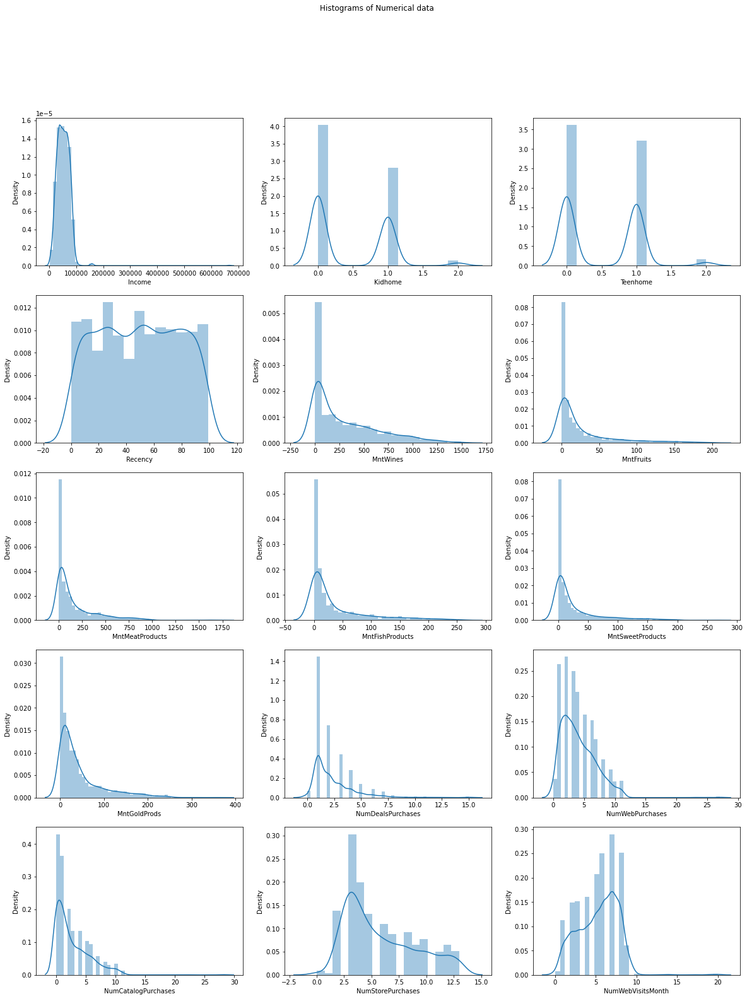

In [22]:
# Distribution Each Data

fig, axs = plt.subplots(5,3, figsize=(20,25))
plt.suptitle('Histograms of Numerical data')

for i, num in enumerate(numerical_cols) :
    sns.distplot(df[num], ax=axs[i//3, i%3])
    
plt.show()

**Detail** : Dari Histogram diatas, tidak ada data dengan distribusi normal dikarenakan variasi data yang cukup banyak didalamnya

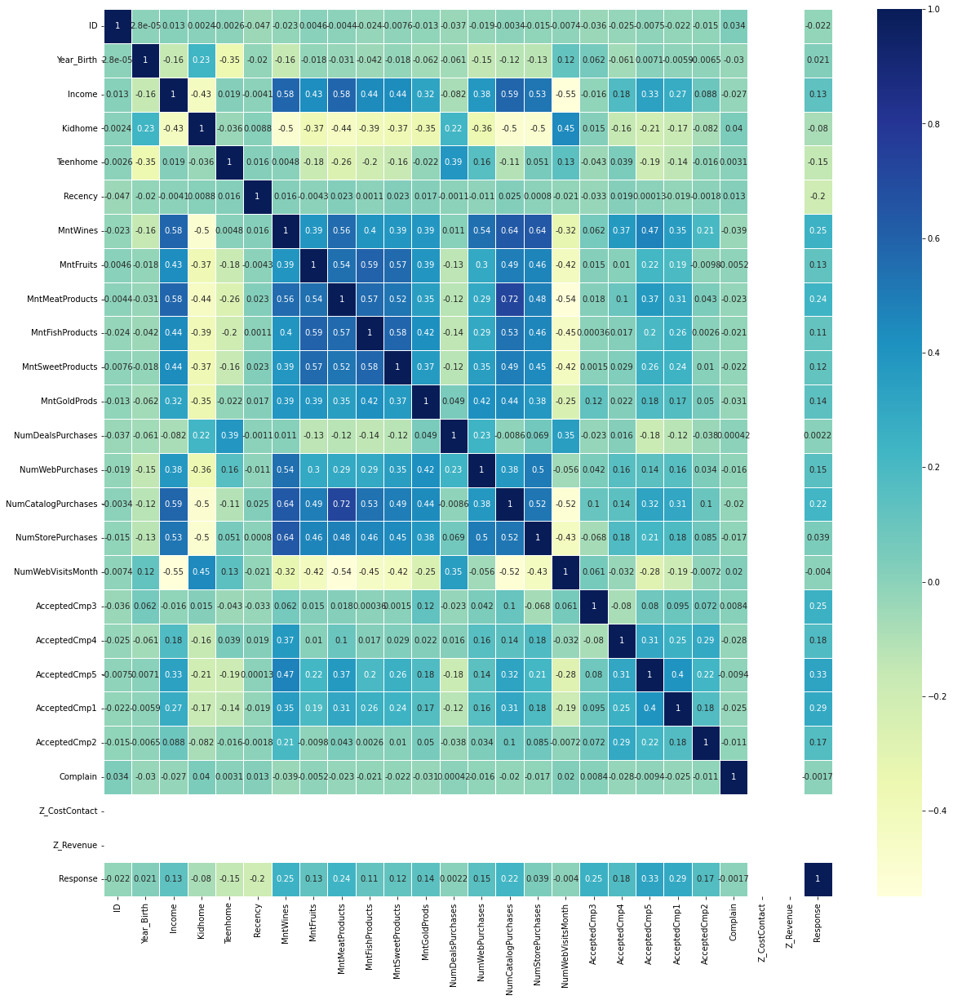

In [23]:
# Correlation per-Numerical Variable

plt.subplots(figsize=(20, 20))
sns.heatmap(df.corr(), cmap="YlGnBu",annot=True, linewidths=0.5)
plt.show()

**Detail** : Dari table korelasi diatas didapatkan beberapa variable dengan korelasi moderate positif. diantaranya NumCatalogPurchase-MntMeatPriducts, NumCatalogPurchase-MntWines, NumStorePurchase-MntWines.

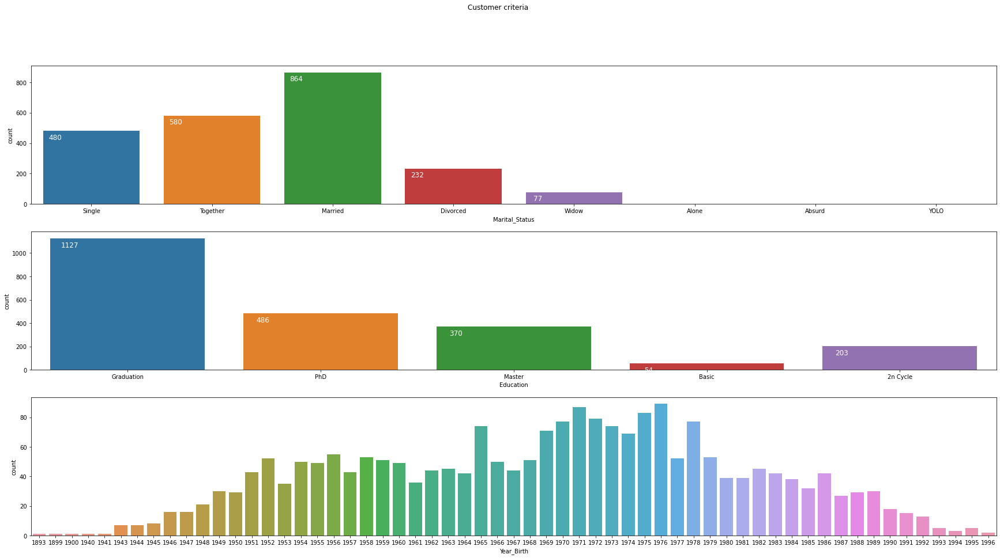

In [24]:
# Customer criteria

fig, axs = plt.subplots(3,1, figsize=(30,15))
plt.suptitle('Customer criteria')

ax1 = sns.countplot(x=df['Marital_Status'], ax=axs[0])
ax2 = sns.countplot(x=df['Education'], ax=axs[1])
ax3 = sns.countplot(x=df['Year_Birth'], ax=axs[2])

for p in ax1.patches:
    ax1.annotate(f'\n{p.get_height()}', (p.get_x()+0.1, p.get_height()+40), ha='center', va='top', color='white', size=12)
for q in ax2.patches:
    ax2.annotate(f'\n{q.get_height()}', (q.get_x()+0.1, q.get_height()+48), ha='center', va='top', color='white', size=12)

plt.show()

**Detail** : Dari grafik diatas, didapatkan Customer paling banyak dengan status marital adalah Married, Education adalah Graduation **dan disusul oleh PhD**, dan Kelahiran tahun 1976.


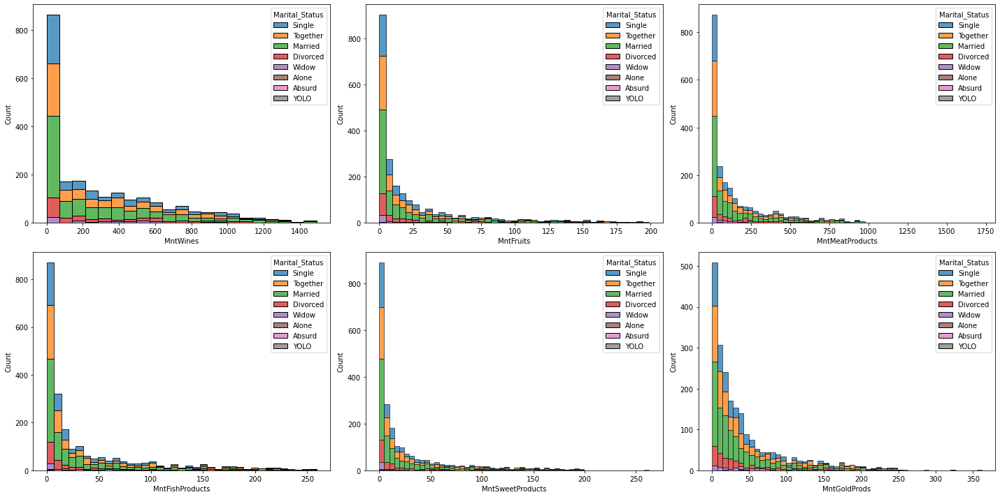

In [25]:
# Amount of Product

Product=['MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds']

plt.figure(figsize=(20,10))
for i,Name in enumerate(Product):
    plt.subplot(2,3,i+1)
    sns.histplot(data=df,x=Name,color='b',hue='Marital_Status', multiple="stack")
plt.tight_layout()
plt.show()

**Detail** : Dari grafik diatas, didapatkan jumlah produk yang dibeli dalam 2 tahun terakhir. Dari semua produk, Customer dengan marital status Married paling banyak membeli semua produk. Pada produk wine, dalam 2 tahun customer dominan berbelanja produk wine dengan total sekitar 0-60 botol.

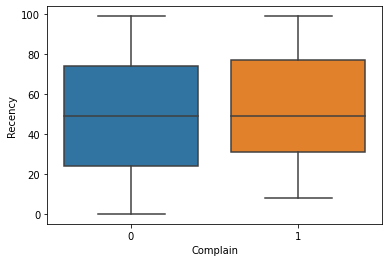

In [26]:
# Compain vs Recency

sns.boxplot(x = "Complain", y = "Recency", data = df)
plt.show()

**Detail** : Grafik diatas menunjukan variasi data recency tidak begitu banyak pada customer complain & sebaliknya variasi data recency pada customer tidak complain cukup banyak. Median keduanya juga hampir sama. Namun hal ini tidak menunjukan komplain mempengaruhi tanggal terakhir karyawan bertransaksi

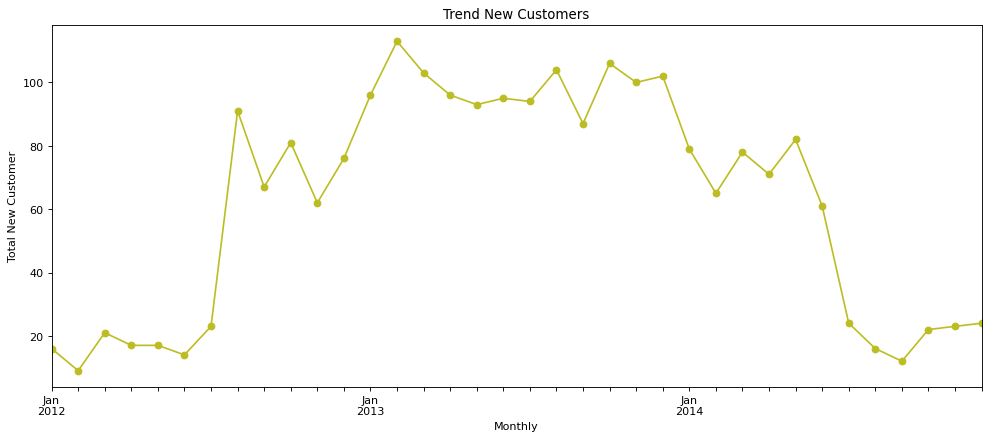

In [27]:
#Copy data

data_trend = df.copy()

#Add new column for monthly count
data_trend['Dt_Customer'] = pd.to_datetime(data_trend['Dt_Customer'])
data_trend['date_col'] = data_trend['Dt_Customer'].dt.to_period('M') 

Trend = data_trend['date_col'].value_counts().sort_index() #generate counts
plt.figure(figsize=(15, 6), dpi=80)

Trend.plot(kind = 'line',color='tab:olive', marker = 'o')

plt.xticks(Trend.index)

plt.xlabel("Monthly")
plt.ylabel("Total New Customer")
plt.title("Trend New Customers")
plt.show()

# Terjadi penambahan besar pada Agustus 2012, namun trend ini tidak berulang sampai dengan 2014. Jadi belum bisa
# .. digunakan sebagai suatu kesimpulan

**Detail** : Grafik diatas menunjukan penambahan customer baru dari tahun ke tahun bersifat fluktuatif, tidak ada trend.

In [28]:
# Education vs Income

med = df.groupby('Education')['Income'].median()
med

Education
2n Cycle      46891.0
Basic         20744.0
Graduation    51651.0
Master        51044.5
PhD           55005.0
Name: Income, dtype: float64

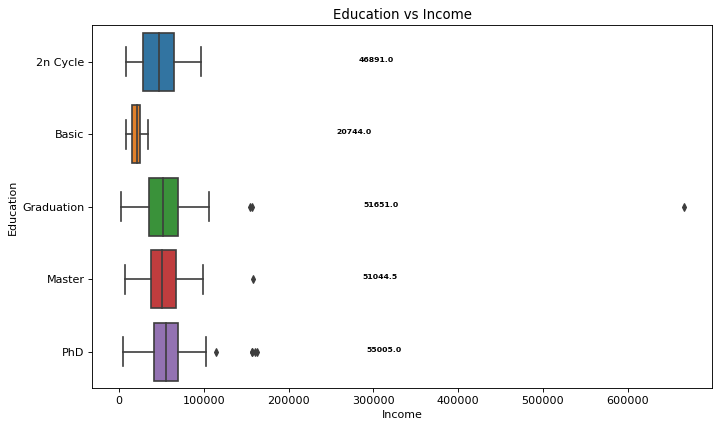

In [29]:
# Graph Education & Income

plt.figure(figsize=(10, 6), dpi=80)
Graph1 = sns.boxplot(x="Income", y="Education", data=df, order=['2n Cycle','Basic','Graduation','Master','PhD'])

h_offset = df['Income'].median()* 5  # offset from median for display

for ytick in Graph1.get_yticks():
    Graph1.text(med[ytick] + h_offset,ytick,med[ytick], 
            horizontalalignment='center',size='x-small',color='black',weight='semibold')
    
plt.xlabel("Income")
plt.ylabel("Education")
plt.title("Education vs Income")
plt.show()

# Terdapat outlier namun dihiraukan saja

**Detail** : Graduation memiliki variasi data yang paling banyak, namun PhD yang memiliki median tertinggi

### Feature Engineering

In [30]:
#Copy data
df_fet = df.copy()

In [31]:
# Check Marital Status

df_fet["Marital_Status"].value_counts()

Married     864
Together    580
Single      480
Divorced    232
Widow        77
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64

**Detail** : Kolom **Marital_Status** memiliki beberapa value yang dapat disederhanakan

In [32]:
# Check Education

df_fet["Education"].value_counts()

Graduation    1127
PhD            486
Master         370
2n Cycle       203
Basic           54
Name: Education, dtype: int64

In [33]:
# Merapikan kolom Marital_Status
df_fet["Marital_Status"] = df_fet["Marital_Status"].replace({"Together": "Married","Alone": "Single", "Absurd": "Single", 
                                                     "Divorced": "Single", "Widow": "Single", "Divorced": "Single", 
                                                     "YOLO": "Single"})
# Merapikan kolom Education
df_fet["Education"] = df_fet["Education"].replace({"2n Cycle": "Master"})

# Menambahkan kolom Age
df_fet["Age"] = 2015 - df["Year_Birth"]                                                 

# Menggabungkan kolom Kidhome dan Teenhome
df_fet["Children"] = df["Kidhome"] + df["Teenhome"]

# Menggabungkan jumlah pembelian (Quantity)
df_fet["Total_Amount"] = df["MntWines"] + df["MntFruits"] + df["MntMeatProducts"] + df["MntFishProducts"] + df["MntSweetProducts"] + df["MntGoldProds"]

# Menggabungkan pembelian semua platform (Frekuensi)
df_fet["Total_Purchase"] = df["NumWebPurchases"] + df["NumCatalogPurchases"] + df["NumStorePurchases"]

df_fet.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Age,Children,Total_Amount,Total_Purchase
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1,58,0,1617,22
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0,61,2,27,4
2,4141,1965,Graduation,Married,71613.0,0,0,21-08-2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0,50,0,776,20
3,6182,1984,Graduation,Married,26646.0,1,0,10-02-2014,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0,31,1,53,6
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0,34,1,422,14


**Detail** : 

- Kolom **Marital Status** disederhanakan menjadi dua kelompok, apakah pengguna tersebut memiliki pasangan (Married) atau tidak (Single)
- Pada kolom **Education** 2n Cycle diubah menjadi Master karena memiliki makna dan tingkatan yang sama
- Menambahkan kolom **Age** dengan mengurangkan tahun dimana data ini diambil (2015) dengan kolom **Year_Birth**
- Kolom **Kidhome** dan **Teenhome** digabungkan menjadi kolom **Children**
- Menggabungkan beberapa kolom jumlah pembelian produk untuk dapat melihat total jumlah pembelian seluruh produk (**Total_Amount**)
- Menambahkan kolom **Total_Purchase** dengan menambahkan frekuensi pembelian dari masing-masing platform (**NumWebPurchases**,  **NumCatalogPurchases**,  **NumStorePurchases**)

In [34]:
# Check new Marital Status

df_fet["Marital_Status"].value_counts()

Married    1444
Single      796
Name: Marital_Status, dtype: int64

In [35]:
# Check new Education

df_fet["Education"].value_counts()

Graduation    1127
Master         573
PhD            486
Basic           54
Name: Education, dtype: int64

In [36]:
# Check Z_CostContract

df_fet["Z_CostContact"].value_counts()

3    2240
Name: Z_CostContact, dtype: int64

In [37]:
# Check Z_Revenue

df_fet["Z_Revenue"].value_counts()

11    2240
Name: Z_Revenue, dtype: int64

In [38]:
# Menghapus kolom yang tidak diperlukan

df_fet.drop(["ID", "Year_Birth", "Dt_Customer", "Z_CostContact", "Z_Revenue", "Kidhome", "Teenhome"], axis=1, inplace=True)
df_fet.head()

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Total_Amount,Total_Purchase
0,Graduation,Single,58138.0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,58,0,1617,22
1,Graduation,Single,46344.0,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,61,2,27,4
2,Graduation,Married,71613.0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,50,0,776,20
3,Graduation,Married,26646.0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,31,1,53,6
4,PhD,Married,58293.0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,34,1,422,14


**Detail** : Menghapus beberapa kolom yang tidak diperlukan
- **ID** Berisikan kolom unik masing-masing user
- **Year_Birth** digantikan dengan kolom numerical **Age**
- **Dt_Customer** hanya berisi tanggal dimana cutomer tersebut mendaftar
- Dari keseluruhan data **Z_CostContact** dan **Z_Revenue** memiliki value yang sama
- Kolom **Kidhome** dan **Teenhome** digabungkan menjadi kolom **Children**

In [39]:
#Data grouping

newnumerical_cols_fet = ['Total_Purchase','Total_Amount','Children','Age']



**Detail** : Dari hasil diatas didapatkan beberapa kolom numerikal baru yang dapat dilakukan analisis kembali

### EDA (Feature Enginering)

In [40]:
# Statistical Summary

df_fet.describe().T # alternatif .transpose()

,count,mean,std,min,25%,50%,75%,max
Income,2240.0,52237.975446,25037.955891,1730.0,35538.75,51381.5,68289.75,666666.0
Recency,2240.0,49.109375,28.962453,0.0,24.00,49.0,74.00,99.0
MntWines,2240.0,303.935714,336.597393,0.0,23.75,173.5,504.25,1493.0
MntFruits,2240.0,26.302232,39.773434,0.0,1.00,8.0,33.00,199.0
MntMeatProducts,2240.0,166.950000,225.715373,0.0,16.00,67.0,232.00,1725.0
MntFishProducts,2240.0,37.525446,54.628979,0.0,3.00,12.0,50.00,259.0
MntSweetProducts,2240.0,27.062946,41.280498,0.0,1.00,8.0,33.00,263.0
MntGoldProds,2240.0,44.021875,52.167439,0.0,9.00,24.0,56.00,362.0
NumDealsPurchases,2240.0,2.325000,1.932238,0.0,1.00,2.0,3.00,15.0
NumWebPurchases,2240.0,4.084821,2.778714,0.0,2.00,4.0,6.00,27.0


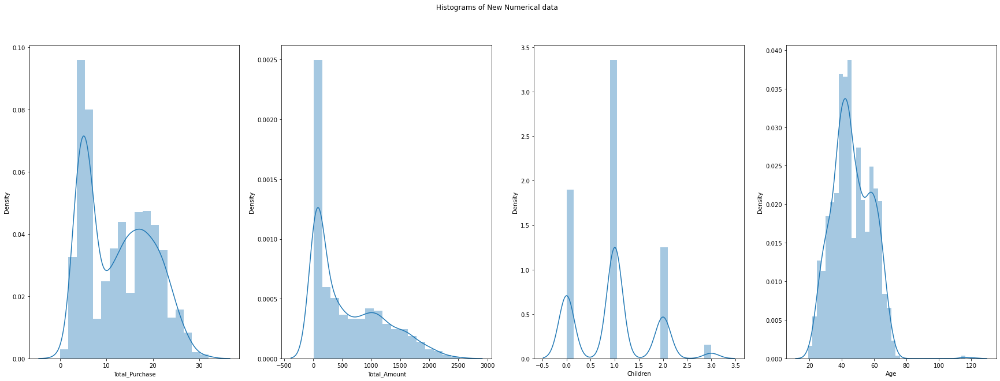

In [41]:
# Distribution Each Data

fig, axs = plt.subplots(1,4, figsize=(30,10))
plt.suptitle('Histograms of New Numerical data')                                

for i, num in enumerate(newnumerical_cols_fet) :
    sns.distplot(df_fet[num], ax=axs[i%4])
    
plt.show()

**Detail** : Dari Histogram diatas, tidak ada data dengan distribusi normal dikarenakan variasi data yang cukup beragam didalamnya

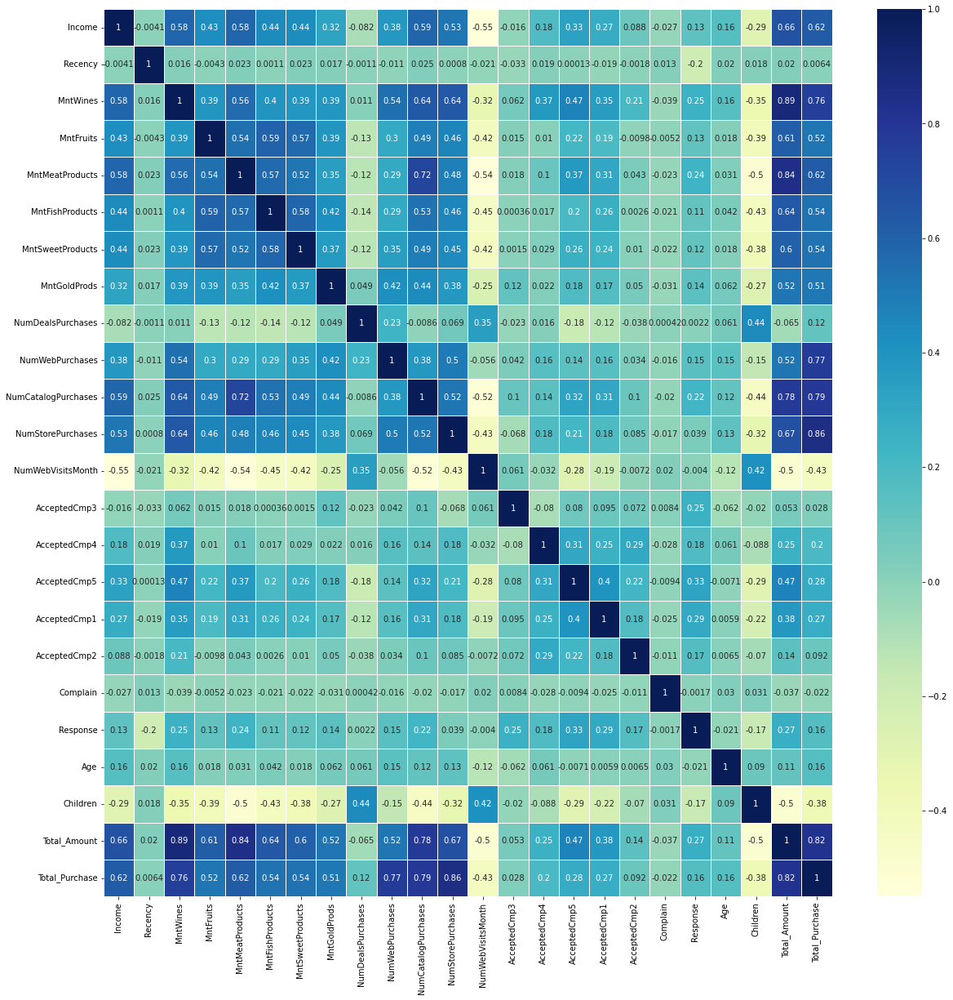

In [42]:
# Correlation per-Numerical Variable

plt.subplots(figsize=(20, 20))
sns.heatmap(df_fet.corr(), cmap="YlGnBu",annot=True, linewidths=0.5)
plt.show()

**Detail** : Dari table korelasi diatas didapatkan beberapa variable dengan korelasi strong & moderate positif. diantaranya 
Total_Amount-NumCatalogPurchase, Total_Amount-Total_Purchase, Total_Purchase-MntWines

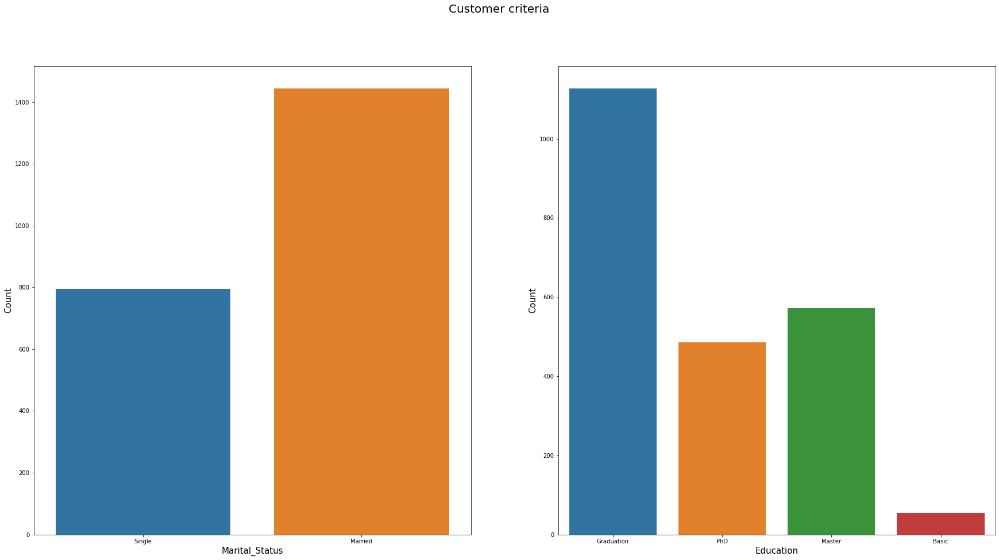

In [43]:
# Customer criteria

fig, axs = plt.subplots(1,2, figsize=(30,15),)
plt.suptitle('Customer criteria', fontsize=20)

ax1 = sns.countplot(x=df_fet['Marital_Status'], ax=axs[0])
ax2 = sns.countplot(x=df_fet['Education'], ax=axs[1])

ax1.set_xlabel('Marital_Status',fontsize=15)
ax1.set_ylabel('Count',fontsize=15)
ax2.set_xlabel('Education',fontsize=15)
ax2.set_ylabel('Count',fontsize=15)

#for p in ax1.patches:
#    ax1.annotate(f'\n{p.get_height()}', (p.get_x()+0.1, p.get_height()+40), ha='center', va='top', color='white', size=12)
#for q in ax2.patches:
#   ax2.annotate(f'\n{q.get_height()}', (q.get_x()+0.1, q.get_height()+48), ha='center', va='top', color='white', size=12)

plt.show()

Text(0, 0.5, 'Count')

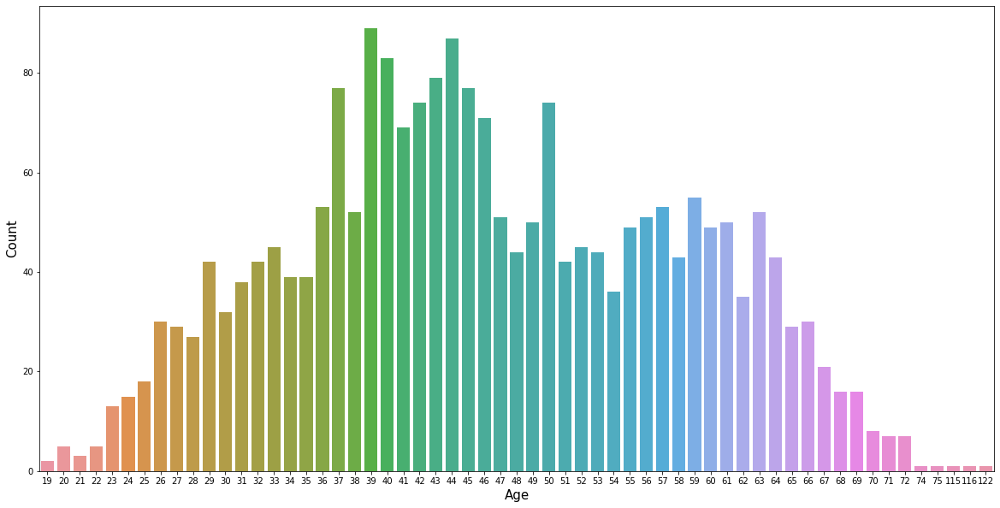

In [44]:
plt.figure(figsize=(20,10))
ax3 = sns.countplot(x=df_fet['Age'])

ax3.set_xlabel('Age',fontsize=15)
ax3.set_ylabel('Count',fontsize=15)

**Detail** : Dari grafik diatas, didapatkan Customer paling banyak dengan status marital Married dan dengan Education paling banyak Graduation **lalu disusul oleh Master**, dan karyawan dengan umur 39 Tahun (1976) per tahun 2015

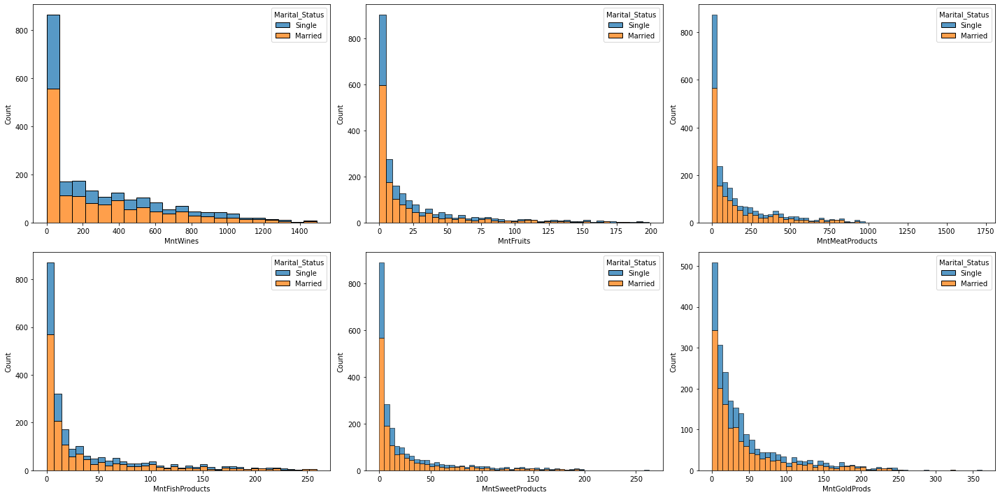

In [45]:
# Product amount vs Maritas status

Product=['MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds']

plt.figure(figsize=(20,10))
for i,Name in enumerate(Product):
    plt.subplot(2,3,i+1)
    sns.histplot(data=df_fet,x=Name,color='b',hue='Marital_Status', multiple="stack")
plt.tight_layout()
plt.show()

**Detail** : Dari grafik diatas, didapatkan jumlah produk yang dibeli dalam 2 tahun terakhir. Dari semua produk, Customer dengan marital status Married paling banyak membeli semua produk. Contohnya pada produk wine, dalam 2 tahun customer dominan berbelanja wine dengan total sekitar 0-60 botol.

In [46]:
# Education vs Income

med2 = df_fet.groupby(['Education'])['Income'].median()
med2

Education
Basic         20744.0
Graduation    51651.0
Master        49681.0
PhD           55005.0
Name: Income, dtype: float64

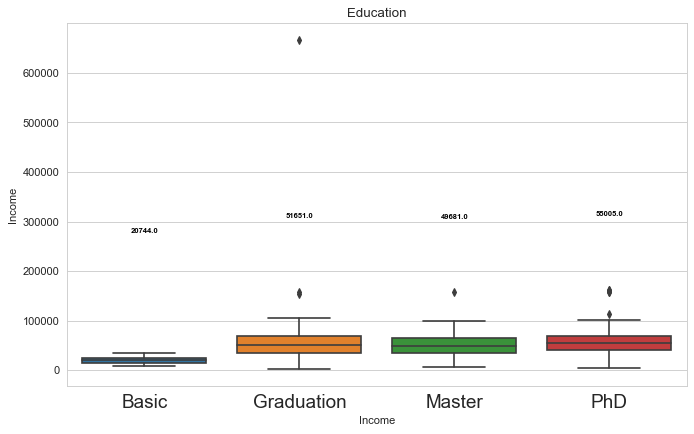

In [47]:
# Graph Education vs Income

plt.figure(figsize=(10, 6), dpi=80)
sns.set_style("whitegrid")
Graph = sns.boxplot(x="Education", y="Income", data=df_fet, order=['Basic','Graduation','Master','PhD'])

v_offset = df_fet['Income'].median()* 5  # offset from median for display

for xtick in Graph.get_xticks():
    Graph.text(xtick,med2[xtick] + v_offset,med2[xtick], 
            horizontalalignment='center',size='x-small',color='black',weight='semibold')

plt.xlabel("Income")
plt.xticks(size=17)
plt.ylabel("Income")
plt.title("Education")
plt.show()

# Terdapat outlier namun dihiraukan saja
# ... Graduation memiliki variasi data yang banyak, namun PHD yang memiliki rata-rata tertinggi

**Detail** : Graduation memiliki variasi data yang paling banyak, namun PhD tetap yang memiliki median tertinggi disusul oleh Graduation & Master. Hal ini menyebabkan Graduation perlu diteliti lebih dalam untuk hal penawaran karena bisa menjadi salah sasaran (karena banyak variasi income).

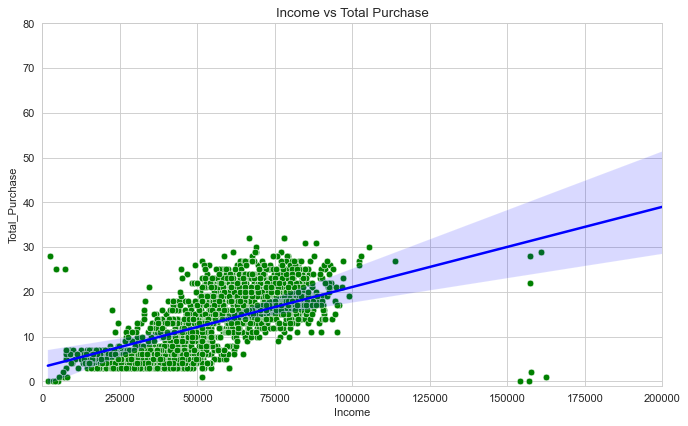

In [48]:
# Income vs Total Purchase

plt.figure(figsize=(10, 6), dpi=80)
sns.scatterplot(df_fet['Income'], df_fet['Total_Purchase'], data=df_fet, color="green")
sns.regplot(df_fet['Income'], df_fet['Total_Purchase'], data=df_fet, scatter=False, color="blue")
plt.xlim([-1, 200000])                                                                              # Editable, Smaller range because outlier
plt.ylim([-1, 80])                                                                                  # Editable

plt.xlabel("Income")
plt.title("Income vs Total Purchase")

plt.show()

**Detail** : Terlihat dari garis biru bahwa dengan semakin besarnya income, customer cenderung melakukan pembelian yang besar pula (semakin besar gaji, semakin konsumtif). Hal ini merupakan relasi positif namun untuk analisa lebih dalam perlu dilakukan pengecekan tanpa outlier

In [49]:
# Jumlah Num Purchase
                                                          
Total_no_purchases = df_fet[df_fet['Total_Purchase'] == 0]
Total_purchases = df_fet[df_fet['Total_Purchase'] > 0]

print("customers that Purchase in other reason:", len(Total_no_purchases))
print("customers that purchase:", len(Total_purchases))

customers that Purchase in other reason: 6
customers that purchase: 2234


In [50]:
# Customer yang tidak melakukan pembayaran

Total_no_purchases

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Total_Amount,Total_Purchase
655,Graduation,Single,153924.0,81,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,40,0,6,0
981,Graduation,Single,4861.0,20,2,1,1,1,0,1,0,0,0,0,14,0,0,0,0,0,0,0,50,0,6,0
1245,Graduation,Single,1730.0,65,1,1,3,1,1,1,15,0,0,0,20,0,0,0,0,0,0,0,44,0,8,0
1524,Graduation,Single,3502.0,56,2,1,1,0,0,1,0,0,0,0,14,0,0,0,0,0,0,0,42,1,5,0
1846,PhD,Married,4023.0,29,5,0,1,1,1,1,15,0,0,0,19,0,0,0,0,0,0,0,52,2,9,0
2132,PhD,Married,156924.0,85,2,1,2,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,66,0,8,0


**Detail** : ada 4 customer (0.1%) yang tidak pernah membayar produk toko melalui 3 media yang ada (web, store, catalog)

In [51]:
# Menentukan media yang paling digemari customer (purchased) berdasarkan marital status     

Purchase = ['NumWebPurchases','NumCatalogPurchases','NumStorePurchases']

def user_most_used_channel(Purchases: pd.Series):
    Purchase
    return Purchase[np.argmax(Purchases)]

Total_purchases['Purchase'] = Total_purchases[Purchase].apply(user_most_used_channel, axis=1).copy()
Total_purchases

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Total_Amount,Total_Purchase,Purchase
0,Graduation,Single,58138.0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,58,0,1617,22,NumCatalogPurchases
1,Graduation,Single,46344.0,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,61,2,27,4,NumStorePurchases
2,Graduation,Married,71613.0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,50,0,776,20,NumStorePurchases
3,Graduation,Married,26646.0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,31,1,53,6,NumStorePurchases
4,PhD,Married,58293.0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,34,1,422,14,NumStorePurchases
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,Graduation,Married,61223.0,46,709,43,182,42,118,247,2,9,3,4,5,0,0,0,0,0,0,0,48,1,1341,16,NumWebPurchases
2236,PhD,Married,64014.0,56,406,0,30,0,0,8,7,8,2,5,7,0,0,0,1,0,0,0,69,3,444,15,NumWebPurchases
2237,Graduation,Single,56981.0,91,908,48,217,32,12,24,1,2,3,13,6,0,1,0,0,0,0,0,34,0,1241,18,NumStorePurchases
2238,Master,Married,69245.0,8,428,30,214,80,30,61,2,6,5,10,3,0,0,0,0,0,0,0,59,1,843,21,NumStorePurchases


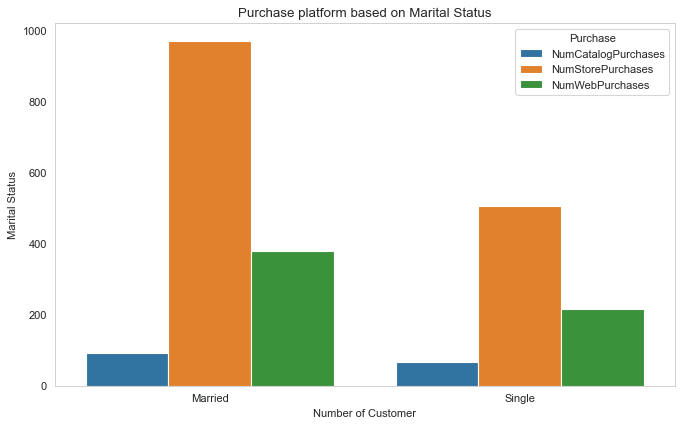

In [52]:
# Purchase media based on Marital Status                                                                         

plt.figure(figsize=(10, 6), dpi=80)
sns.countplot(
    x="Marital_Status", data=Total_purchases, hue="Purchase",
    order=Total_purchases.Marital_Status.value_counts().index
)
plt.grid(False)
plt.xlabel("Number of Customer")
plt.ylabel("Marital Status")
plt.title("Purchase platform based on Marital Status")
plt.show()

**Detail** : Cutomer dengan status married maupun single sangat tertarik dengan pembelanjaan melalui toko dan kurang tertarik dengan pembelanjaan melalui katalog. Selain itu customer married menjadi kelompok customer yang paling sering melakukan pembelian di seluruh media pada toko jika dibandingkan dengan single.

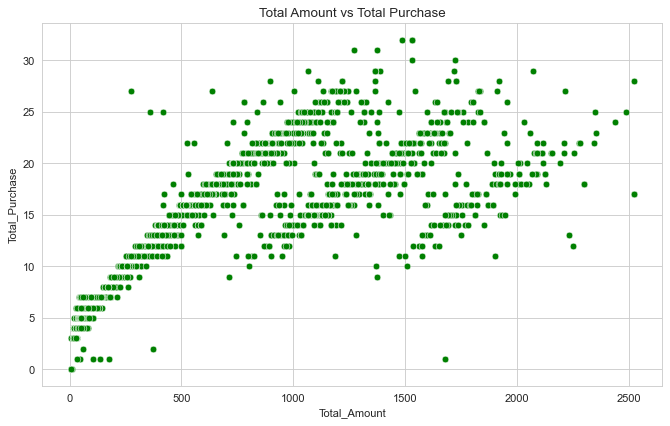

In [53]:
# Total Amount vs Total Purchase

plt.figure(figsize=(10, 6), dpi=80)
sns.scatterplot(df_fet['Total_Amount'], df_fet['Total_Purchase'], data=df_fet, color="green")

plt.title("Total Amount vs Total Purchase")

plt.show()

**Detail** : Total amount dan total purchase memiliki korelasi positif moderate 

### Encoding & Scaling

In [54]:
# Label Encoding

le = LabelEncoder()
obj_columns = ["Marital_Status"]                                        
for i in obj_columns:
    df_fet[i] = df_fet[[i]].apply(le.fit_transform)

# Find & Replace Encoding
df_fet["Education"] = df_fet["Education"].replace({"PhD": 3,"Master": 2, "Graduation": 1, "Basic": 0})      # Education encodingnya harus urut karena dapat mempengaruhi hasil, pakai find & replace

df_fet

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Total_Amount,Total_Purchase
0,1,1,58138.0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,58,0,1617,22
1,1,1,46344.0,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,61,2,27,4
2,1,0,71613.0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,50,0,776,20
3,1,0,26646.0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,31,1,53,6
4,3,0,58293.0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,34,1,422,14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,0,61223.0,46,709,43,182,42,118,247,2,9,3,4,5,0,0,0,0,0,0,0,48,1,1341,16
2236,3,0,64014.0,56,406,0,30,0,0,8,7,8,2,5,7,0,0,0,1,0,0,0,69,3,444,15
2237,1,1,56981.0,91,908,48,217,32,12,24,1,2,3,13,6,0,1,0,0,0,0,0,34,0,1241,18
2238,2,0,69245.0,8,428,30,214,80,30,61,2,6,5,10,3,0,0,0,0,0,0,0,59,1,843,21


**Detail** : Marital Status tidak memandang urutan, disini kami menggunakan label encoding. Education bersifat ordinal sehingga encodingnya harus urut karena dapat mempengaruhi hasil, oleh karena itu kami menggunakann encoding manual, yaitu find & replace

In [55]:
# Scaling

In [56]:
df_fet.describe().T

,count,mean,std,min,25%,50%,75%,max
Education,2240.0,1.665625,0.839658,0.0,1.00,1.0,2.00,3.0
Marital_Status,2240.0,0.355357,0.478728,0.0,0.00,0.0,1.00,1.0
Income,2240.0,52237.975446,25037.955891,1730.0,35538.75,51381.5,68289.75,666666.0
Recency,2240.0,49.109375,28.962453,0.0,24.00,49.0,74.00,99.0
MntWines,2240.0,303.935714,336.597393,0.0,23.75,173.5,504.25,1493.0
MntFruits,2240.0,26.302232,39.773434,0.0,1.00,8.0,33.00,199.0
MntMeatProducts,2240.0,166.950000,225.715373,0.0,16.00,67.0,232.00,1725.0
MntFishProducts,2240.0,37.525446,54.628979,0.0,3.00,12.0,50.00,259.0
MntSweetProducts,2240.0,27.062946,41.280498,0.0,1.00,8.0,33.00,263.0
MntGoldProds,2240.0,44.021875,52.167439,0.0,9.00,24.0,56.00,362.0


**Detail** : Dari tabel deskripsi diatas, dapat disimpulkan ada beberapa kolom yang perlu discaling (Non Binary) dan tidak perlu discaling (Binary). sehingga kami kelompokan menjadi berikut :

In [57]:
df_fet.columns

Index(['Education', 'Marital_Status', 'Income', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response', 'Age', 'Children',
       'Total_Amount', 'Total_Purchase'],
      dtype='object')

In [58]:
scaling = ['Income', 
       'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'Age', 'Total_Amount',
       'Total_Purchase']
non_scaling = ['Education', 'Marital_Status', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'Response', 'Children']

In [59]:
df_fet[non_scaling]

,Education,Marital_Status,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children
0,1,1,0,0,0,0,0,0,1,0
1,1,1,0,0,0,0,0,0,0,2
2,1,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,1
4,3,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...
2235,1,0,0,0,0,0,0,0,0,1
2236,3,0,0,0,0,1,0,0,0,3
2237,1,1,0,1,0,0,0,0,0,0
2238,2,0,0,0,0,0,0,0,0,1


In [60]:
scaler = preprocessing.MinMaxScaler()

# fit on data column
df_scale = scaler.fit_transform(df_fet[scaling])
df_scale = pd.DataFrame(df_scale, columns = scaling)
df_scale

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Age,Total_Amount,Total_Purchase
0,0.084832,0.585859,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,0.307692,0.35,0.378641,0.639683,0.68750
1,0.067095,0.383838,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,0.153846,0.25,0.407767,0.008730,0.12500
2,0.105097,0.262626,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,0.769231,0.20,0.300971,0.305952,0.62500
3,0.037471,0.262626,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,0.307692,0.30,0.116505,0.019048,0.18750
4,0.085065,0.949495,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,0.461538,0.25,0.145631,0.165476,0.43750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,0.089472,0.464646,0.474883,0.216080,0.105507,0.162162,0.448669,0.682320,0.133333,0.333333,0.107143,0.307692,0.25,0.281553,0.530159,0.50000
2236,0.093669,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,0.022099,0.466667,0.296296,0.071429,0.384615,0.35,0.485437,0.174206,0.46875
2237,0.083092,0.919192,0.608171,0.241206,0.125797,0.123552,0.045627,0.066298,0.066667,0.074074,0.107143,1.000000,0.30,0.145631,0.490476,0.56250
2238,0.101536,0.080808,0.286671,0.150754,0.124058,0.308880,0.114068,0.168508,0.133333,0.222222,0.178571,0.769231,0.15,0.388350,0.332540,0.65625


**Detail** : MinMax Scaler dilakukan untuk data yang distribusinya tidak normal. Scaling dilakukan dengan MinMax Scaler dikarenakan secara teori tidak ada metode scaling terbaik untuk data tertentu.

In [61]:
# Concat data

df_fix = pd.concat([df_fet[non_scaling],df_scale], axis = 1)
df_fix

,Education,Marital_Status,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Age,Total_Amount,Total_Purchase
0,1,1,0,0,0,0,0,0,1,0,0.084832,0.585859,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,0.307692,0.35,0.378641,0.639683,0.68750
1,1,1,0,0,0,0,0,0,0,2,0.067095,0.383838,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,0.153846,0.25,0.407767,0.008730,0.12500
2,1,0,0,0,0,0,0,0,0,0,0.105097,0.262626,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,0.769231,0.20,0.300971,0.305952,0.62500
3,1,0,0,0,0,0,0,0,0,1,0.037471,0.262626,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,0.307692,0.30,0.116505,0.019048,0.18750
4,3,0,0,0,0,0,0,0,0,1,0.085065,0.949495,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,0.461538,0.25,0.145631,0.165476,0.43750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,0,0,0,0,0,0,0,0,1,0.089472,0.464646,0.474883,0.216080,0.105507,0.162162,0.448669,0.682320,0.133333,0.333333,0.107143,0.307692,0.25,0.281553,0.530159,0.50000
2236,3,0,0,0,0,1,0,0,0,3,0.093669,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,0.022099,0.466667,0.296296,0.071429,0.384615,0.35,0.485437,0.174206,0.46875
2237,1,1,0,1,0,0,0,0,0,0,0.083092,0.919192,0.608171,0.241206,0.125797,0.123552,0.045627,0.066298,0.066667,0.074074,0.107143,1.000000,0.30,0.145631,0.490476,0.56250
2238,2,0,0,0,0,0,0,0,0,1,0.101536,0.080808,0.286671,0.150754,0.124058,0.308880,0.114068,0.168508,0.133333,0.222222,0.178571,0.769231,0.15,0.388350,0.332540,0.65625


**Detail** : Data yang digunakan untuk modeling adalah data_fix

## Import Data Hasil Scaling

In [62]:
# Import Library

import pandas as pd
pd.set_option('display.max_columns', 50)

import numpy as np
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering as AC

from yellowbrick.cluster import KElbowVisualizer
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

In [63]:
# Import Data

df = pd.read_csv('/Users/mcbookair/Desktop/Final Project Bootcamp/Cahya-scaling.csv') # Min-max scaller
df

,Education,Marital_Status,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Age,Total_Amount,Total_Purchase
0,1,1,0,0,0,0,0,0,1,0,0.084832,0.585859,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,0.307692,0.35,0.378641,0.639683,0.68750
1,1,1,0,0,0,0,0,0,0,2,0.067095,0.383838,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,0.153846,0.25,0.407767,0.008730,0.12500
2,1,0,0,0,0,0,0,0,0,0,0.105097,0.262626,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,0.769231,0.20,0.300971,0.305952,0.62500
3,1,0,0,0,0,0,0,0,0,1,0.037471,0.262626,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,0.307692,0.30,0.116505,0.019048,0.18750
4,3,0,0,0,0,0,0,0,0,1,0.085065,0.949495,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,0.461538,0.25,0.145631,0.165476,0.43750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,0,0,0,0,0,0,0,0,1,0.089472,0.464646,0.474883,0.216080,0.105507,0.162162,0.448669,0.682320,0.133333,0.333333,0.107143,0.307692,0.25,0.281553,0.530159,0.50000
2236,3,0,0,0,0,1,0,0,0,3,0.093669,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,0.022099,0.466667,0.296296,0.071429,0.384615,0.35,0.485437,0.174206,0.46875
2237,1,1,0,1,0,0,0,0,0,0,0.083092,0.919192,0.608171,0.241206,0.125797,0.123552,0.045627,0.066298,0.066667,0.074074,0.107143,1.000000,0.30,0.145631,0.490476,0.56250
2238,2,0,0,0,0,0,0,0,0,1,0.101536,0.080808,0.286671,0.150754,0.124058,0.308880,0.114068,0.168508,0.133333,0.222222,0.178571,0.769231,0.15,0.388350,0.332540,0.65625


In [64]:
df.shape

(2240, 26)

<Figure size 864x576 with 0 Axes>

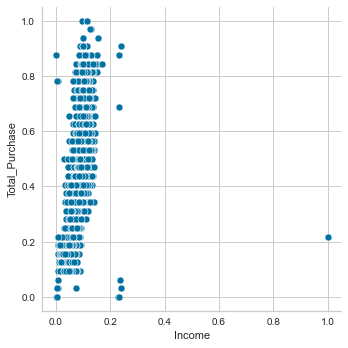

In [65]:
# Plot data before clustering

plt.figure(figsize=(12,8))
sns.relplot(x='Income',y='Total_Purchase',data=df,palette='tab10')              # memvisualisasikan hubungan statistik menggunakan dua pendekatan umum: plot scatter dan plot garis

### PCA

In [66]:
# Define n variable reduction

def variance_score(no_comp):                                                    
    pca = PCA(n_components = no_comp)
    pca.fit(df)
    
    variance = pca.explained_variance_ratio_.sum() * 100
    print("Explained Variance Ratio for `{}` = {}%".format(no_comp, variance))
    
components = range(1,26)                                                         # Component = dimension
for i in components:
    variance_score(i)
                                                                                

Explained Variance Ratio for `1` = 29.459560862312586%
Explained Variance Ratio for `2` = 57.17332539226682%
Explained Variance Ratio for `3` = 66.79152706165583%
Explained Variance Ratio for `4` = 74.74623069641069%
Explained Variance Ratio for `5` = 80.36513434098845%
Explained Variance Ratio for `6` = 83.937247315299%
Explained Variance Ratio for `7` = 87.06408256793151%
Explained Variance Ratio for `8` = 89.26675245393615%
Explained Variance Ratio for `9` = 91.35368574614722%
Explained Variance Ratio for `10` = 92.9425710898877%
Explained Variance Ratio for `11` = 94.25558556012939%
Explained Variance Ratio for `12` = 95.12131312464636%
Explained Variance Ratio for `13` = 95.8105616476776%
Explained Variance Ratio for `14` = 96.47098038902776%
Explained Variance Ratio for `15` = 97.02698866531637%
Explained Variance Ratio for `16` = 97.54618967856388%
Explained Variance Ratio for `17` = 98.02992827787442%
Explained Variance Ratio for `18` = 98.49088755732076%
Explained Variance Rat

In [67]:
pca=PCA()
pca.fit(df)

PCA()

[]

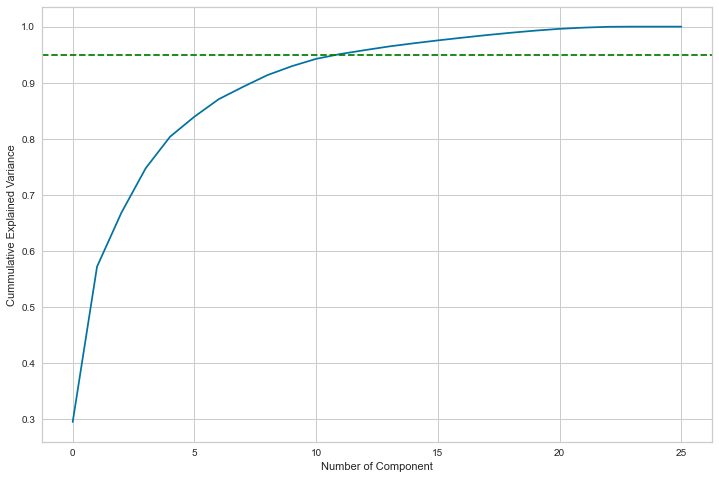

In [68]:
# Plot variance with 95%

plt.figure(figsize=(12,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Component')
plt.ylabel('Cummulative Explained Variance')
plt.axhline(y=0.95, linestyle='--', color='green')                              # variance to be between 95–99%
plt.plot()                                                                      # Sumber : https://www.mikulskibartosz.name/pca-how-to-choose-the-number-of-components/

**Detail** : Variable reduction is 12, n_component = 12

In [69]:
# Fitting PCA

pca_final = PCA(n_components = 12, random_state=42)
df_pca = pca_final.fit_transform(df)
df_pca = pd.DataFrame(df_pca)
df_pca

,0,1,2,3,4,5,6,7,8,9,10,11
0,-1.045429,-0.944165,0.745007,0.281666,0.195865,-0.201738,0.295645,-0.598952,-0.101336,0.055021,0.253822,-0.352725
1,-0.204632,1.324616,0.677443,-0.033203,-0.047611,-0.015479,-0.135507,0.073969,0.184915,-0.042745,0.057618,-0.058679
2,-0.977929,-0.650462,-0.446312,-0.150142,-0.152790,-0.339733,-0.145887,0.004122,-0.131479,0.028217,-0.075669,0.111794
3,-0.546301,0.513730,-0.356576,-0.322670,0.211170,-0.112467,-0.187174,0.041146,0.036247,-0.014539,-0.034597,0.045687
4,1.262197,-0.358782,-0.406917,-0.179089,-0.264606,0.213665,0.278634,-0.197553,0.000218,0.049378,0.045458,0.108939
...,...,...,...,...,...,...,...,...,...,...,...,...
2235,-0.650014,0.146596,-0.371776,0.329850,-0.211571,-0.178115,0.071783,-0.027761,0.004770,-0.051957,0.089937,-0.417817
2236,1.963962,1.209512,-0.259447,0.939609,-0.104194,0.163155,0.008754,0.143317,0.574515,0.641018,-0.380544,-0.084632
2237,-0.990307,-0.793534,0.520811,0.082560,-0.523273,0.652495,-0.377982,0.131201,-0.702547,0.128974,0.101623,0.161600
2238,0.302062,-0.202017,-0.391382,0.237177,-0.193472,-0.492599,-0.215324,0.063777,-0.033955,-0.004407,-0.059635,0.067929


In [70]:
# Rename column

df_pca = df_pca.rename(columns={0: 'PCA_1',1: 'PCA_2',
                                2: 'PCA_3',3: 'PCA_4',
                                4: 'PCA_5',5: 'PCA_6',
                                6: 'PCA_7',7: 'PCA_8',
                                8: 'PCA_9',9: 'PCA_10',
                                10: 'PCA_11',11: 'PCA_12'})
df_pca

,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12
0,-1.045429,-0.944165,0.745007,0.281666,0.195865,-0.201738,0.295645,-0.598952,-0.101336,0.055021,0.253822,-0.352725
1,-0.204632,1.324616,0.677443,-0.033203,-0.047611,-0.015479,-0.135507,0.073969,0.184915,-0.042745,0.057618,-0.058679
2,-0.977929,-0.650462,-0.446312,-0.150142,-0.152790,-0.339733,-0.145887,0.004122,-0.131479,0.028217,-0.075669,0.111794
3,-0.546301,0.513730,-0.356576,-0.322670,0.211170,-0.112467,-0.187174,0.041146,0.036247,-0.014539,-0.034597,0.045687
4,1.262197,-0.358782,-0.406917,-0.179089,-0.264606,0.213665,0.278634,-0.197553,0.000218,0.049378,0.045458,0.108939
...,...,...,...,...,...,...,...,...,...,...,...,...
2235,-0.650014,0.146596,-0.371776,0.329850,-0.211571,-0.178115,0.071783,-0.027761,0.004770,-0.051957,0.089937,-0.417817
2236,1.963962,1.209512,-0.259447,0.939609,-0.104194,0.163155,0.008754,0.143317,0.574515,0.641018,-0.380544,-0.084632
2237,-0.990307,-0.793534,0.520811,0.082560,-0.523273,0.652495,-0.377982,0.131201,-0.702547,0.128974,0.101623,0.161600
2238,0.302062,-0.202017,-0.391382,0.237177,-0.193472,-0.492599,-0.215324,0.063777,-0.033955,-0.004407,-0.059635,0.067929


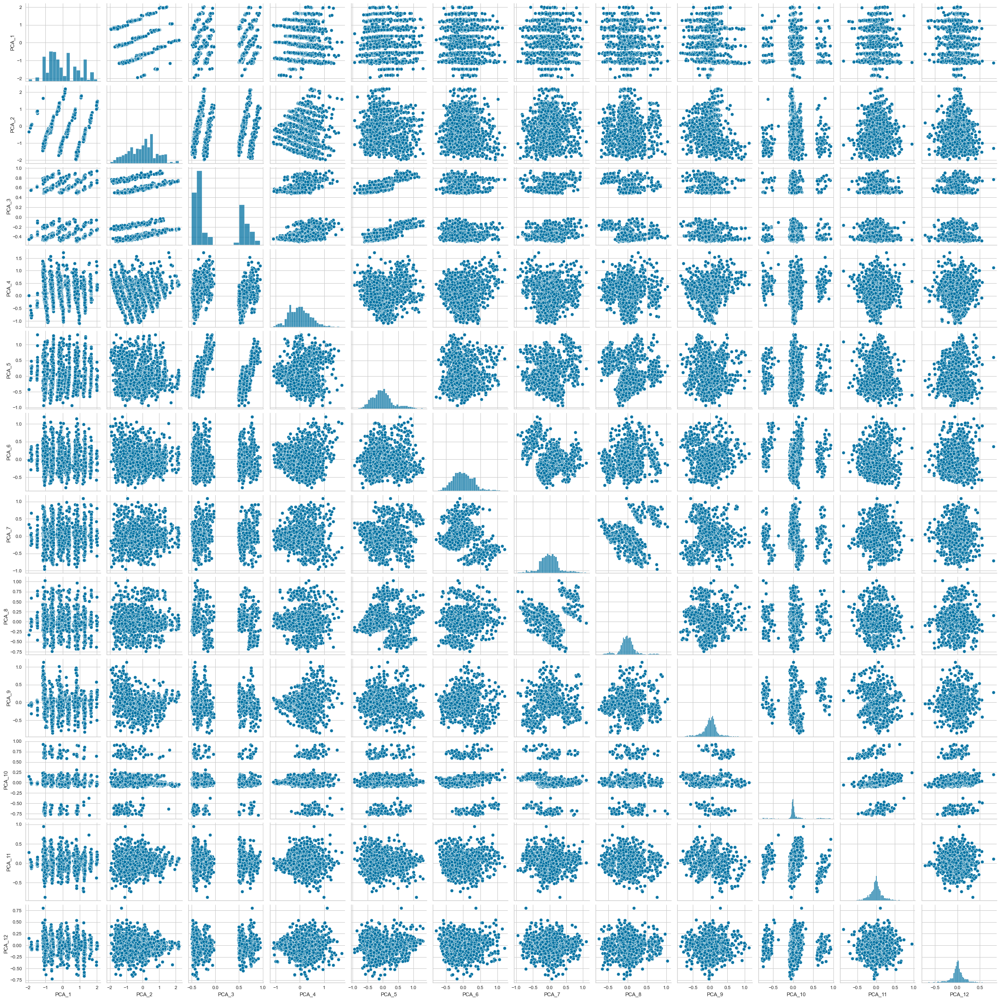

In [71]:
# Plot data after PCA

sns.pairplot(df_pca, palette='tab10')

### KMEANS

#### 1. Define K-Elbow

In [72]:
# Define K Manually

inertia = []
K = range(1,11)                                                                 
for i in K:                                                                      
    kmeanModel = KMeans(n_clusters=i, random_state=123)
    kmeanModel.fit(df_pca)
    inertia.append(kmeanModel.inertia_)
df_pca_inertia = pd.DataFrame({'Inertia':inertia}, index=[i for i in range(1,11)])
df_pca_inertia

,Inertia
1,5185.042626
2,3914.121538
3,3245.666850
4,2902.725163
5,2702.478076
6,2461.403861
7,2320.585957
8,2196.115016
9,2068.934125
10,1990.802438


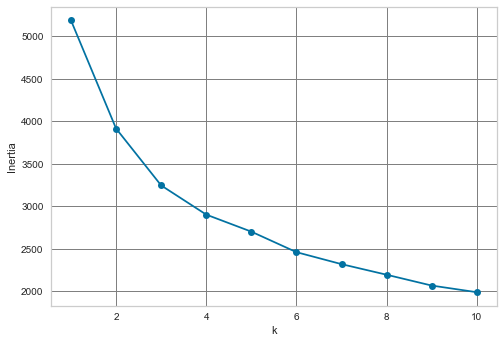

In [73]:
# Plot K & Inertia

plt.plot(K, inertia, 'bo-')
plt.grid(color='gray')
plt.xlabel('k')
plt.ylabel('Inertia')
plt.show()

**Detail** : Berdasarkan grafik inertia diatas, dapat ditetapkan bahwasanya *Knee* berada pada k = 4

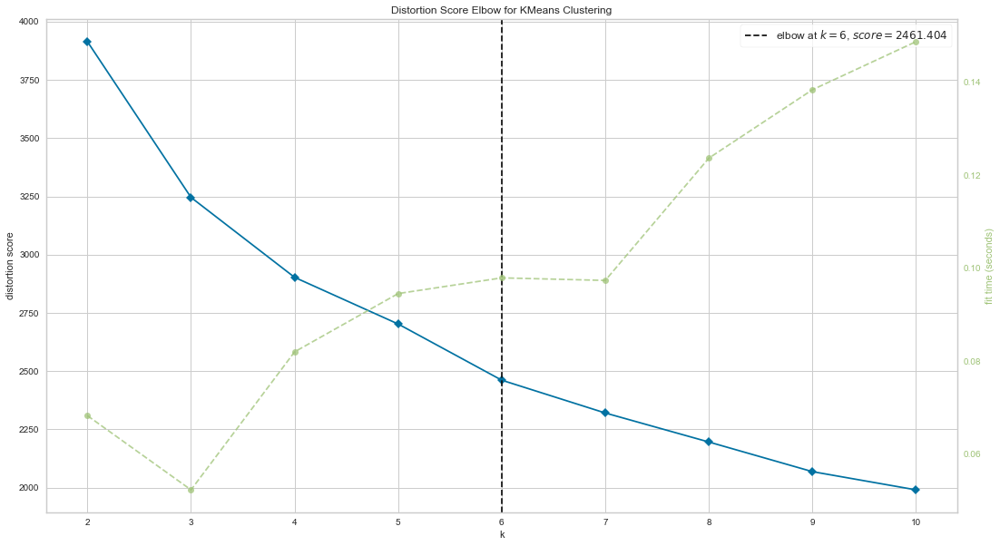

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [74]:
# Define K use elbow visualizer

plt.figure(figsize=(18,10))
elbow = KElbowVisualizer(KMeans(random_state=123), k=10)                                        # Gambarnya diperbesar
elbow.fit(df_pca)
elbow.show()

**Detail** : Berdasarkan grafik *Elbow visualizer* diatas, dapat ditetapkan bahwasanya *Knee* berada pada k = 6

Jadi, akan digunakan **k = 6** sebagai modeling K-Means

#### 2. Fitting Model

In [75]:
# Fitting model with n = 6

model_km = KMeans(n_clusters=6, random_state=123)
result = model_km.fit_predict(df_pca)

result

array([4, 0, 4, ..., 4, 2, 5], dtype=int32)

In [76]:
df_pca_kmeans = df_pca.copy()

In [77]:
# Table cluster

df_pca_kmeans['Cluster Kmeans'] = result
df_pca_kmeans

,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,Cluster Kmeans
0,-1.045429,-0.944165,0.745007,0.281666,0.195865,-0.201738,0.295645,-0.598952,-0.101336,0.055021,0.253822,-0.352725,4
1,-0.204632,1.324616,0.677443,-0.033203,-0.047611,-0.015479,-0.135507,0.073969,0.184915,-0.042745,0.057618,-0.058679,0
2,-0.977929,-0.650462,-0.446312,-0.150142,-0.152790,-0.339733,-0.145887,0.004122,-0.131479,0.028217,-0.075669,0.111794,4
3,-0.546301,0.513730,-0.356576,-0.322670,0.211170,-0.112467,-0.187174,0.041146,0.036247,-0.014539,-0.034597,0.045687,1
4,1.262197,-0.358782,-0.406917,-0.179089,-0.264606,0.213665,0.278634,-0.197553,0.000218,0.049378,0.045458,0.108939,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,-0.650014,0.146596,-0.371776,0.329850,-0.211571,-0.178115,0.071783,-0.027761,0.004770,-0.051957,0.089937,-0.417817,1
2236,1.963962,1.209512,-0.259447,0.939609,-0.104194,0.163155,0.008754,0.143317,0.574515,0.641018,-0.380544,-0.084632,5
2237,-0.990307,-0.793534,0.520811,0.082560,-0.523273,0.652495,-0.377982,0.131201,-0.702547,0.128974,0.101623,0.161600,4
2238,0.302062,-0.202017,-0.391382,0.237177,-0.193472,-0.492599,-0.215324,0.063777,-0.033955,-0.004407,-0.059635,0.067929,2


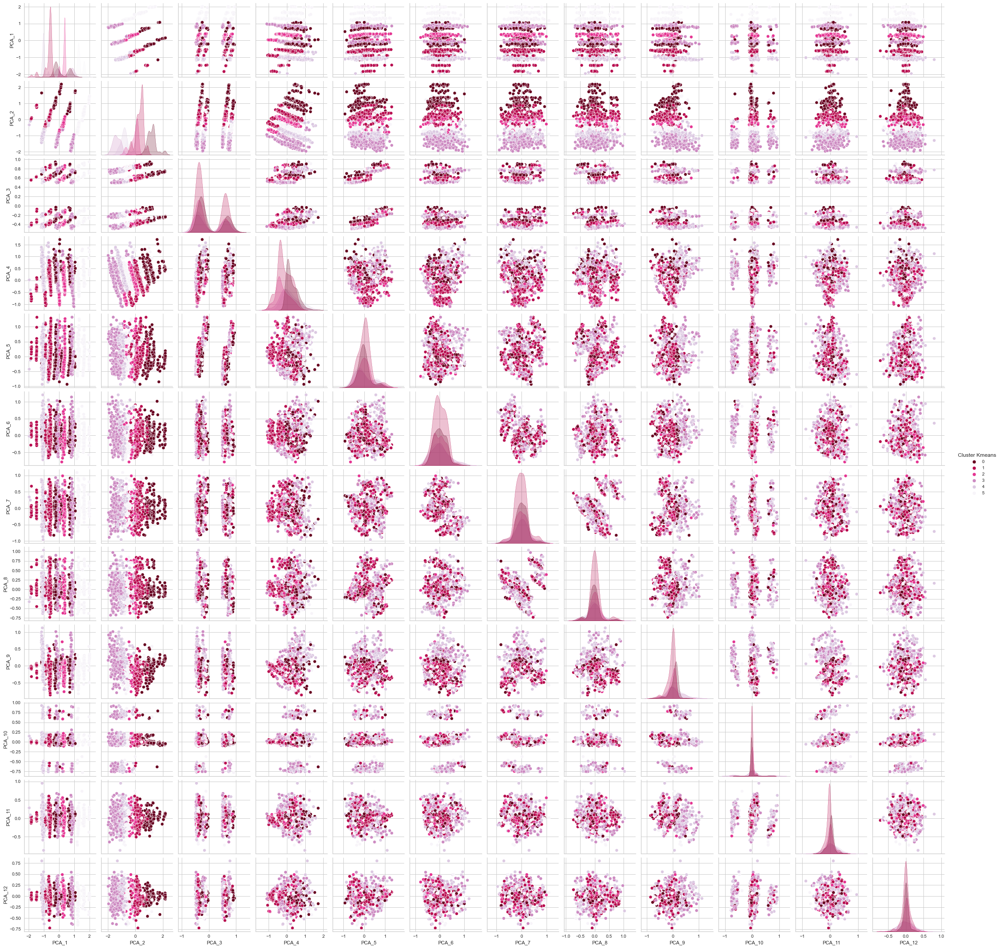

In [78]:
# Plot data after KMeans

sns.pairplot(df_pca_kmeans, hue = 'Cluster Kmeans', palette='PuRd_r')

In [79]:
# Detail Cluster

Kmeans_clust_sizes = df_pca_kmeans.groupby('Cluster Kmeans').size().to_frame()
Kmeans_clust_sizes.columns = ["KMeans_size"]
Kmeans_clust_sizes

,KMeans_size
Cluster Kmeans,
0,357
1,669
2,315
3,264
4,283
5,352


**Detail** : Dari jumlah cluster dan detail diatas, dapat dikatakan bahwa cluster yang terbentuk cukup memiliki size yang cukup merata pada cluster tersebut, hanya saja cluster 1 memiliki jumlah yang jauh berbeda dengan yang lain.

perlu diperdalam lagi terkait dengan size yang cukup berbeda

### DBSCAN

#### 1. Define eps_values & min samples

In [80]:
# Investigating eps val & minsamples

from itertools import product

eps_values = np.arange(0.25,1.5,0.2) # eps values to be investigated            # Random choose
min_samples = np.arange(12,25) # min_samples values to be investigated          # Min samples should be >= Data dimension
DBSCAN_params = list(product(eps_values, min_samples))

In [81]:
# Find number of cluster varian

no_of_clusters = []
sil_score = []

for p in DBSCAN_params:
    DBS_clustering = DBSCAN(eps=p[0], min_samples=p[1]).fit(df_pca)
    no_of_clusters.append(len(np.unique(DBS_clustering.labels_)))
    sil_score.append(silhouette_score(df_pca, DBS_clustering.labels_))



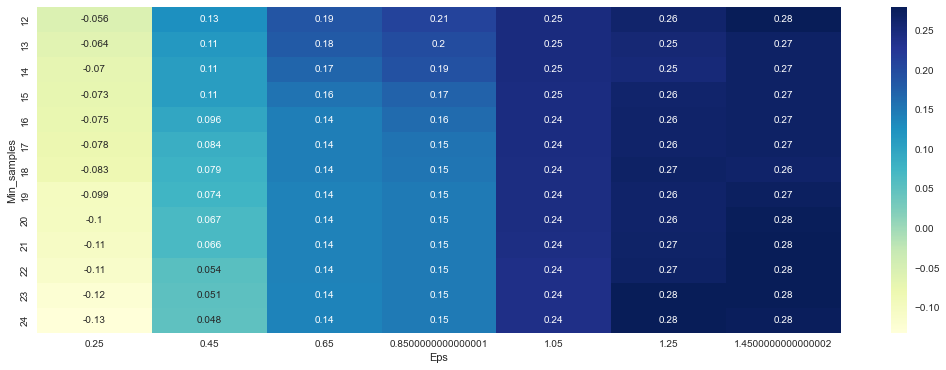

In [82]:
# Plot Var                                                                      

tmp = pd.DataFrame.from_records(DBSCAN_params, columns =['Eps', 'Min_samples'])   
tmp['Sil_score'] = sil_score

pivot_1 = pd.pivot_table(tmp, values='Sil_score', index='Min_samples', columns='Eps')

fig, ax = plt.subplots(figsize=(18,6))
sns.heatmap(pivot_1, annot=True, annot_kws={"size": 10}, cmap="YlGnBu", ax=ax)
plt.show()


**Detail** : Dari heatmap diatas, nilai silhouette score terbaik ada pada 0.28, yaitu epsilon 1.25 dan 1.45 dan min samples 20-24.

Jadi epsilon dan minsamples yang digunakan adalah epsilon terkecil dan minsample terbesar dengan silhouetter score terbaik yaitu eps : 1.25 & minsamples : 24

#### 2. Fitting Model

In [83]:
# eps = 1.25 , min_samples 24

model_dbsc_1 = DBSCAN(eps=1.25, min_samples=24).fit(df_pca)                     # semakin kecil eps & min samples, n cluster semakin banyak
labels_a = model_dbsc_1.labels_
print('Cluster yang terbentuk : ', pd.unique(labels_a))
print(labels_a)

Cluster yang terbentuk :  [ 0 -1]
[0 0 0 ... 0 0 0]


**Detail** : Dikarenakan hasil menunjukan hanya ada 2 cluster dan salah satunya outlier. maka kita coba dengan nilai epsilon dan min samples yang lain

In [84]:
# eps = 1 , min_samples 13

model_dbsc_2 = DBSCAN(eps=1, min_samples=13).fit(df_pca)
labels_b = model_dbsc_2.labels_
print('Cluster yang terbentuk : ', pd.unique(labels_b))
print(labels_b)

Cluster yang terbentuk :  [ 0 -1  1  2]
[ 0  0  0 ... -1  0  0]


**Detail** : dengan epsilon dan min samples diatas, dihasilkan 4 cluster dengan salah satunya outlier. dimana jika dilihat dari heatmap memiliki sihouette score = 0.25

In [85]:
df_pca_dbscan = df_pca.copy()

In [86]:
# Table cluster

df_pca_dbscan['Cluster DBSCAN'] = labels_b
df_pca_dbscan

,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,Cluster DBSCAN
0,-1.045429,-0.944165,0.745007,0.281666,0.195865,-0.201738,0.295645,-0.598952,-0.101336,0.055021,0.253822,-0.352725,0
1,-0.204632,1.324616,0.677443,-0.033203,-0.047611,-0.015479,-0.135507,0.073969,0.184915,-0.042745,0.057618,-0.058679,0
2,-0.977929,-0.650462,-0.446312,-0.150142,-0.152790,-0.339733,-0.145887,0.004122,-0.131479,0.028217,-0.075669,0.111794,0
3,-0.546301,0.513730,-0.356576,-0.322670,0.211170,-0.112467,-0.187174,0.041146,0.036247,-0.014539,-0.034597,0.045687,0
4,1.262197,-0.358782,-0.406917,-0.179089,-0.264606,0.213665,0.278634,-0.197553,0.000218,0.049378,0.045458,0.108939,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,-0.650014,0.146596,-0.371776,0.329850,-0.211571,-0.178115,0.071783,-0.027761,0.004770,-0.051957,0.089937,-0.417817,0
2236,1.963962,1.209512,-0.259447,0.939609,-0.104194,0.163155,0.008754,0.143317,0.574515,0.641018,-0.380544,-0.084632,-1
2237,-0.990307,-0.793534,0.520811,0.082560,-0.523273,0.652495,-0.377982,0.131201,-0.702547,0.128974,0.101623,0.161600,-1
2238,0.302062,-0.202017,-0.391382,0.237177,-0.193472,-0.492599,-0.215324,0.063777,-0.033955,-0.004407,-0.059635,0.067929,0


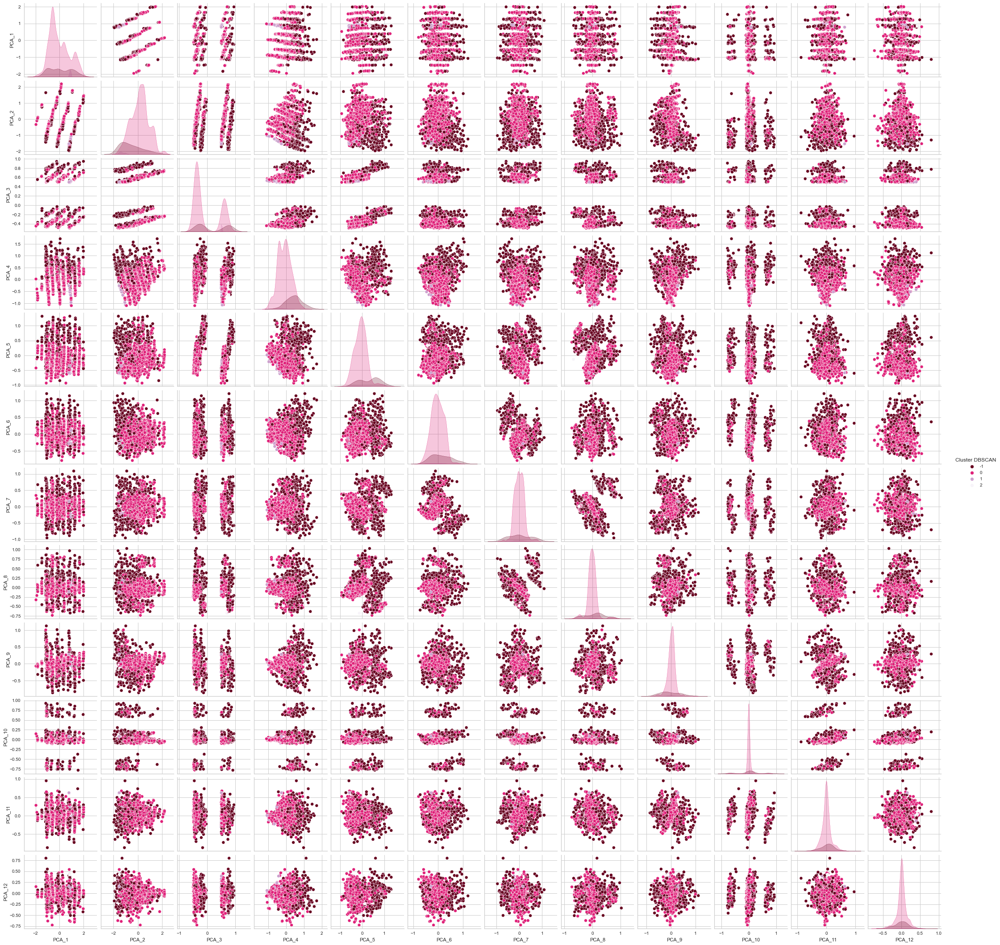

In [87]:
# Plot data after DBSCAN

sns.pairplot(df_pca_dbscan, hue = 'Cluster DBSCAN', palette='PuRd_r')

In [88]:
# Detail Cluster

DBSCAN_clust_sizes = df_pca_dbscan.groupby('Cluster DBSCAN').size().to_frame()
DBSCAN_clust_sizes.columns = ["DBSCAN_size"]
DBSCAN_clust_sizes

,DBSCAN_size
Cluster DBSCAN,
-1,404
0,1803
1,19
2,14


**Detail** : Dari size cluster diatas didapatkan 3 cluster dengan cluster 0 memiliki jumlah yang jauh lebih banyak dari cluster lainnya. Dimana terdapat teori bahwa Kepadatan di semua cluster seharusnya adalah sama.

Hal ini perlu dicek lebih lanjut

### HC (Hierarchical Clustering)

**Metode Aglomerative**

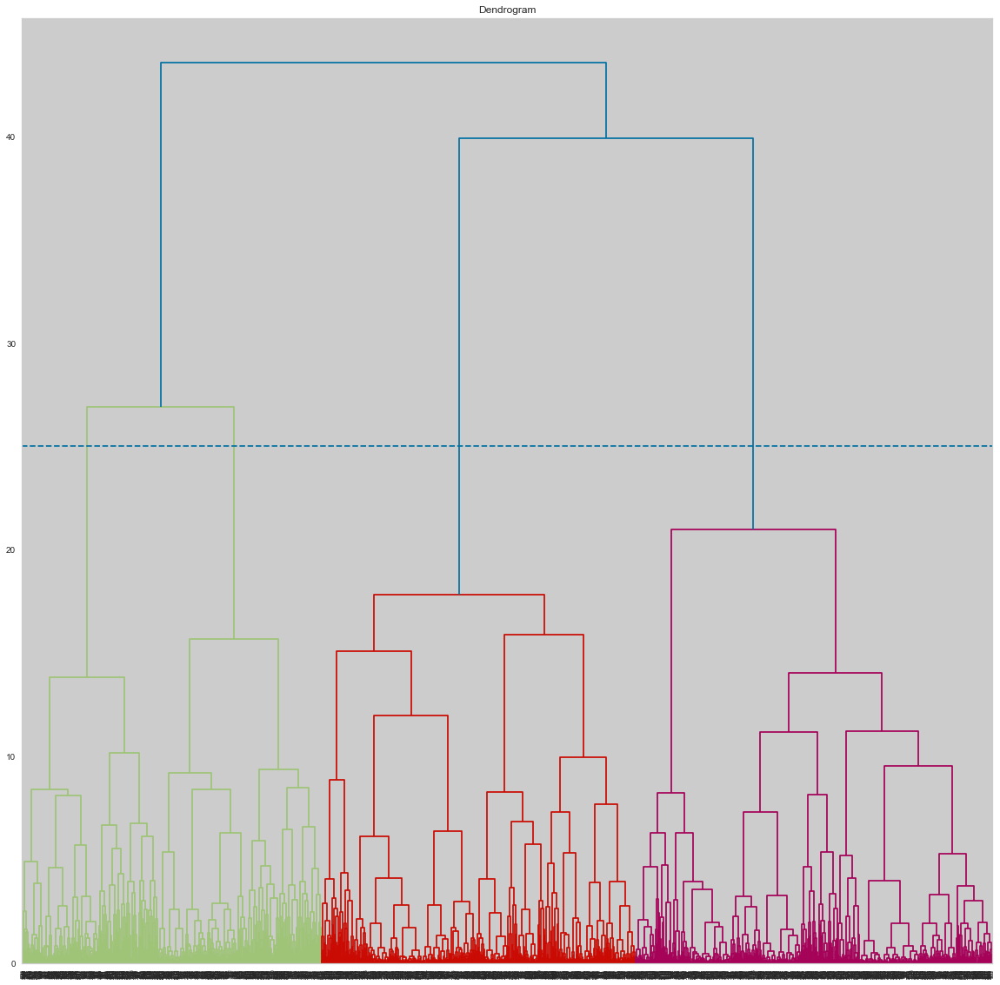

In [89]:
plt.figure(figsize=(20,20))
plt.title('Dendrogram')
plt.axhline(y=200, linestyle='--')
dend = sch.dendrogram(sch.linkage(df_pca.iloc[:, :], method='ward'))
#plt.axhline(y=30, color='r', linestyle='--')                                   
plt.axhline(y=25, color='b', linestyle='--')

In [90]:
modelAC = AC(n_clusters=4)
modelAC = modelAC.fit_predict(df_pca)

print('Cluster yang terbentuk : ', pd.unique(modelAC))
print(modelAC)

Cluster yang terbentuk :  [1 0 2 3]
[1 0 1 ... 1 2 2]


In [91]:
df_pca_hc = df_pca.copy()

In [92]:
# Table cluster

df_pca_hc['Cluster HC'] = modelAC
df_pca_hc

,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,Cluster HC
0,-1.045429,-0.944165,0.745007,0.281666,0.195865,-0.201738,0.295645,-0.598952,-0.101336,0.055021,0.253822,-0.352725,1
1,-0.204632,1.324616,0.677443,-0.033203,-0.047611,-0.015479,-0.135507,0.073969,0.184915,-0.042745,0.057618,-0.058679,0
2,-0.977929,-0.650462,-0.446312,-0.150142,-0.152790,-0.339733,-0.145887,0.004122,-0.131479,0.028217,-0.075669,0.111794,1
3,-0.546301,0.513730,-0.356576,-0.322670,0.211170,-0.112467,-0.187174,0.041146,0.036247,-0.014539,-0.034597,0.045687,0
4,1.262197,-0.358782,-0.406917,-0.179089,-0.264606,0.213665,0.278634,-0.197553,0.000218,0.049378,0.045458,0.108939,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,-0.650014,0.146596,-0.371776,0.329850,-0.211571,-0.178115,0.071783,-0.027761,0.004770,-0.051957,0.089937,-0.417817,0
2236,1.963962,1.209512,-0.259447,0.939609,-0.104194,0.163155,0.008754,0.143317,0.574515,0.641018,-0.380544,-0.084632,2
2237,-0.990307,-0.793534,0.520811,0.082560,-0.523273,0.652495,-0.377982,0.131201,-0.702547,0.128974,0.101623,0.161600,1
2238,0.302062,-0.202017,-0.391382,0.237177,-0.193472,-0.492599,-0.215324,0.063777,-0.033955,-0.004407,-0.059635,0.067929,2


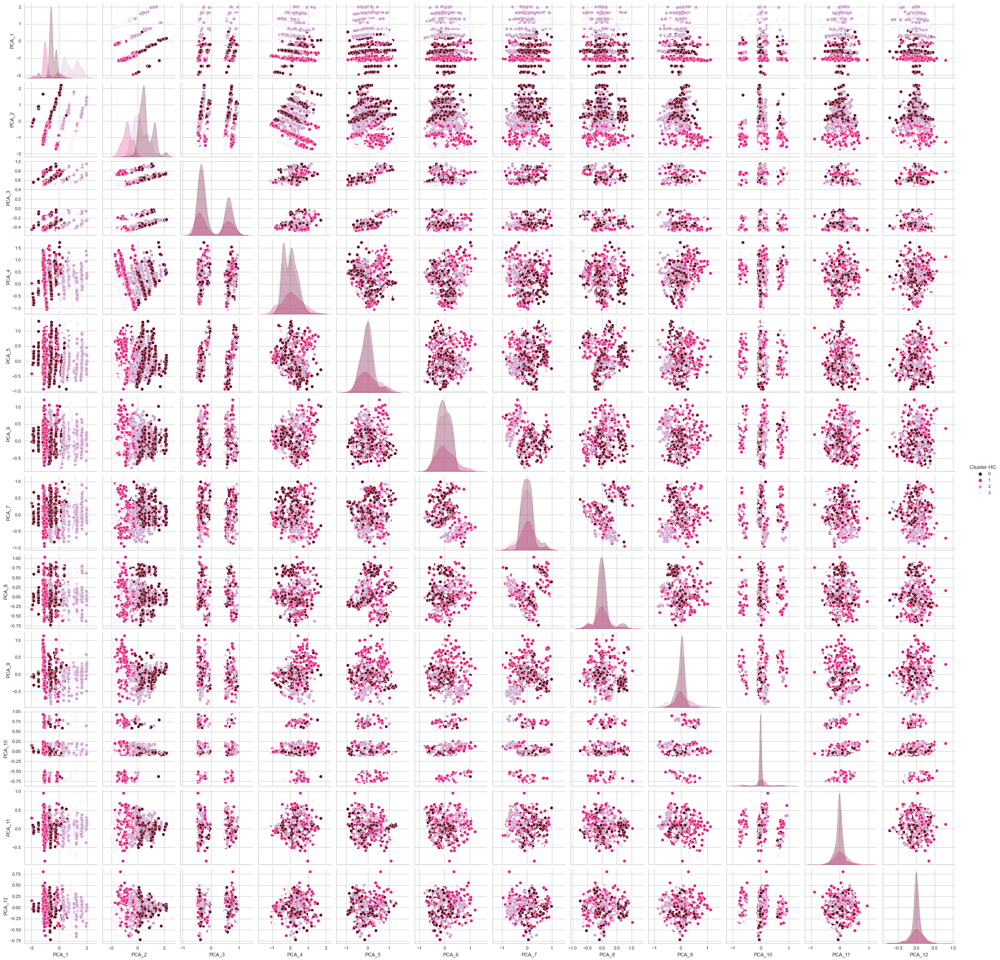

In [93]:
# Plot data after HC

sns.pairplot(df_pca_hc, hue = 'Cluster HC', palette='PuRd_r')

In [94]:
# Detail Cluster

HC_clust_sizes = df_pca_hc.groupby('Cluster HC').size().to_frame()
HC_clust_sizes.columns = ["HC_size"]
HC_clust_sizes

,HC_size
Cluster HC,
0,825
1,377
2,724
3,314


**Detail** : Dari jumlah cluster dan detail diatas, dapat dikatakan bahwa cluster yang terbentuk cukup memiliki size yang cukup jauh antara cluster 0-2 dan cluster 1-3. Dari size diatas hampir sama dengan size pada Kmeans

perlu diperdalam lagi terkait dengan size yang cukup berbeda

### Cluster with Data Scale

In [95]:
# Data scale

data = pd.read_csv('/Users/mcbookair/Desktop/Final Project Bootcamp/Cahya-scaling.csv')
data

,Education,Marital_Status,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Age,Total_Amount,Total_Purchase
0,1,1,0,0,0,0,0,0,1,0,0.084832,0.585859,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,0.307692,0.35,0.378641,0.639683,0.68750
1,1,1,0,0,0,0,0,0,0,2,0.067095,0.383838,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,0.153846,0.25,0.407767,0.008730,0.12500
2,1,0,0,0,0,0,0,0,0,0,0.105097,0.262626,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,0.769231,0.20,0.300971,0.305952,0.62500
3,1,0,0,0,0,0,0,0,0,1,0.037471,0.262626,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,0.307692,0.30,0.116505,0.019048,0.18750
4,3,0,0,0,0,0,0,0,0,1,0.085065,0.949495,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,0.461538,0.25,0.145631,0.165476,0.43750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,0,0,0,0,0,0,0,0,1,0.089472,0.464646,0.474883,0.216080,0.105507,0.162162,0.448669,0.682320,0.133333,0.333333,0.107143,0.307692,0.25,0.281553,0.530159,0.50000
2236,3,0,0,0,0,1,0,0,0,3,0.093669,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,0.022099,0.466667,0.296296,0.071429,0.384615,0.35,0.485437,0.174206,0.46875
2237,1,1,0,1,0,0,0,0,0,0,0.083092,0.919192,0.608171,0.241206,0.125797,0.123552,0.045627,0.066298,0.066667,0.074074,0.107143,1.000000,0.30,0.145631,0.490476,0.56250
2238,2,0,0,0,0,0,0,0,0,1,0.101536,0.080808,0.286671,0.150754,0.124058,0.308880,0.114068,0.168508,0.133333,0.222222,0.178571,0.769231,0.15,0.388350,0.332540,0.65625


In [96]:
# Data Scale & Cluster Kmeans

data["Cluster_KM"] = result
data

,Education,Marital_Status,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Age,Total_Amount,Total_Purchase,Cluster_KM
0,1,1,0,0,0,0,0,0,1,0,0.084832,0.585859,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,0.307692,0.35,0.378641,0.639683,0.68750,4
1,1,1,0,0,0,0,0,0,0,2,0.067095,0.383838,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,0.153846,0.25,0.407767,0.008730,0.12500,0
2,1,0,0,0,0,0,0,0,0,0,0.105097,0.262626,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,0.769231,0.20,0.300971,0.305952,0.62500,4
3,1,0,0,0,0,0,0,0,0,1,0.037471,0.262626,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,0.307692,0.30,0.116505,0.019048,0.18750,1
4,3,0,0,0,0,0,0,0,0,1,0.085065,0.949495,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,0.461538,0.25,0.145631,0.165476,0.43750,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,0,0,0,0,0,0,0,0,1,0.089472,0.464646,0.474883,0.216080,0.105507,0.162162,0.448669,0.682320,0.133333,0.333333,0.107143,0.307692,0.25,0.281553,0.530159,0.50000,1
2236,3,0,0,0,0,1,0,0,0,3,0.093669,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,0.022099,0.466667,0.296296,0.071429,0.384615,0.35,0.485437,0.174206,0.46875,5
2237,1,1,0,1,0,0,0,0,0,0,0.083092,0.919192,0.608171,0.241206,0.125797,0.123552,0.045627,0.066298,0.066667,0.074074,0.107143,1.000000,0.30,0.145631,0.490476,0.56250,4
2238,2,0,0,0,0,0,0,0,0,1,0.101536,0.080808,0.286671,0.150754,0.124058,0.308880,0.114068,0.168508,0.133333,0.222222,0.178571,0.769231,0.15,0.388350,0.332540,0.65625,2


In [97]:
# Data Scale, Cluster Kmeans, & DBSCAN

data["Cluster_DB"] = labels_b
data

,Education,Marital_Status,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Age,Total_Amount,Total_Purchase,Cluster_KM,Cluster_DB
0,1,1,0,0,0,0,0,0,1,0,0.084832,0.585859,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,0.307692,0.35,0.378641,0.639683,0.68750,4,0
1,1,1,0,0,0,0,0,0,0,2,0.067095,0.383838,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,0.153846,0.25,0.407767,0.008730,0.12500,0,0
2,1,0,0,0,0,0,0,0,0,0,0.105097,0.262626,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,0.769231,0.20,0.300971,0.305952,0.62500,4,0
3,1,0,0,0,0,0,0,0,0,1,0.037471,0.262626,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,0.307692,0.30,0.116505,0.019048,0.18750,1,0
4,3,0,0,0,0,0,0,0,0,1,0.085065,0.949495,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,0.461538,0.25,0.145631,0.165476,0.43750,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,0,0,0,0,0,0,0,0,1,0.089472,0.464646,0.474883,0.216080,0.105507,0.162162,0.448669,0.682320,0.133333,0.333333,0.107143,0.307692,0.25,0.281553,0.530159,0.50000,1,0
2236,3,0,0,0,0,1,0,0,0,3,0.093669,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,0.022099,0.466667,0.296296,0.071429,0.384615,0.35,0.485437,0.174206,0.46875,5,-1
2237,1,1,0,1,0,0,0,0,0,0,0.083092,0.919192,0.608171,0.241206,0.125797,0.123552,0.045627,0.066298,0.066667,0.074074,0.107143,1.000000,0.30,0.145631,0.490476,0.56250,4,-1
2238,2,0,0,0,0,0,0,0,0,1,0.101536,0.080808,0.286671,0.150754,0.124058,0.308880,0.114068,0.168508,0.133333,0.222222,0.178571,0.769231,0.15,0.388350,0.332540,0.65625,2,0


In [98]:
# Data Scale, Cluster Kmeans, DBSCAN, HC

data["Cluster_HC"] = modelAC
data

,Education,Marital_Status,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Age,Total_Amount,Total_Purchase,Cluster_KM,Cluster_DB,Cluster_HC
0,1,1,0,0,0,0,0,0,1,0,0.084832,0.585859,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,0.307692,0.35,0.378641,0.639683,0.68750,4,0,1
1,1,1,0,0,0,0,0,0,0,2,0.067095,0.383838,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,0.153846,0.25,0.407767,0.008730,0.12500,0,0,0
2,1,0,0,0,0,0,0,0,0,0,0.105097,0.262626,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,0.769231,0.20,0.300971,0.305952,0.62500,4,0,1
3,1,0,0,0,0,0,0,0,0,1,0.037471,0.262626,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,0.307692,0.30,0.116505,0.019048,0.18750,1,0,0
4,3,0,0,0,0,0,0,0,0,1,0.085065,0.949495,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,0.461538,0.25,0.145631,0.165476,0.43750,5,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,0,0,0,0,0,0,0,0,1,0.089472,0.464646,0.474883,0.216080,0.105507,0.162162,0.448669,0.682320,0.133333,0.333333,0.107143,0.307692,0.25,0.281553,0.530159,0.50000,1,0,0
2236,3,0,0,0,0,1,0,0,0,3,0.093669,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,0.022099,0.466667,0.296296,0.071429,0.384615,0.35,0.485437,0.174206,0.46875,5,-1,2
2237,1,1,0,1,0,0,0,0,0,0,0.083092,0.919192,0.608171,0.241206,0.125797,0.123552,0.045627,0.066298,0.066667,0.074074,0.107143,1.000000,0.30,0.145631,0.490476,0.56250,4,-1,1
2238,2,0,0,0,0,0,0,0,0,1,0.101536,0.080808,0.286671,0.150754,0.124058,0.308880,0.114068,0.168508,0.133333,0.222222,0.178571,0.769231,0.15,0.388350,0.332540,0.65625,2,0,2


### Evaluation Metrics

In [99]:
data.iloc[:, :]

,Education,Marital_Status,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Children,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,Age,Total_Amount,Total_Purchase,Cluster_KM,Cluster_DB,Cluster_HC
0,1,1,0,0,0,0,0,0,1,0,0.084832,0.585859,0.425318,0.442211,0.316522,0.664093,0.334601,0.243094,0.200000,0.296296,0.357143,0.307692,0.35,0.378641,0.639683,0.68750,4,0,1
1,1,1,0,0,0,0,0,0,0,2,0.067095,0.383838,0.007368,0.005025,0.003478,0.007722,0.003802,0.016575,0.133333,0.037037,0.035714,0.153846,0.25,0.407767,0.008730,0.12500,0,0,0
2,1,0,0,0,0,0,0,0,0,0,0.105097,0.262626,0.285332,0.246231,0.073623,0.428571,0.079848,0.116022,0.066667,0.296296,0.071429,0.769231,0.20,0.300971,0.305952,0.62500,4,0,1
3,1,0,0,0,0,0,0,0,0,1,0.037471,0.262626,0.007368,0.020101,0.011594,0.038610,0.011407,0.013812,0.133333,0.074074,0.000000,0.307692,0.30,0.116505,0.019048,0.18750,1,0,0
4,3,0,0,0,0,0,0,0,0,1,0.085065,0.949495,0.115874,0.216080,0.068406,0.177606,0.102662,0.041436,0.333333,0.185185,0.107143,0.461538,0.25,0.145631,0.165476,0.43750,5,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,0,0,0,0,0,0,0,0,1,0.089472,0.464646,0.474883,0.216080,0.105507,0.162162,0.448669,0.682320,0.133333,0.333333,0.107143,0.307692,0.25,0.281553,0.530159,0.50000,1,0,0
2236,3,0,0,0,0,1,0,0,0,3,0.093669,0.565657,0.271936,0.000000,0.017391,0.000000,0.000000,0.022099,0.466667,0.296296,0.071429,0.384615,0.35,0.485437,0.174206,0.46875,5,-1,2
2237,1,1,0,1,0,0,0,0,0,0,0.083092,0.919192,0.608171,0.241206,0.125797,0.123552,0.045627,0.066298,0.066667,0.074074,0.107143,1.000000,0.30,0.145631,0.490476,0.56250,4,-1,1
2238,2,0,0,0,0,0,0,0,0,1,0.101536,0.080808,0.286671,0.150754,0.124058,0.308880,0.114068,0.168508,0.133333,0.222222,0.178571,0.769231,0.15,0.388350,0.332540,0.65625,2,0,2


In [100]:
siluet_km = silhouette_score(data.iloc[:, :], data['Cluster_KM'])
calinski_km = calinski_harabasz_score(data.iloc[:, :], data['Cluster_KM'])
dbi_km = davies_bouldin_score(data.iloc[:, :], data['Cluster_KM'])

siluet_db = silhouette_score(data.iloc[:, :], data['Cluster_DB'])
calinski_db = calinski_harabasz_score(data.iloc[:, :], data['Cluster_DB'])
dbi_db = davies_bouldin_score(data.iloc[:, :], data['Cluster_DB'])

siluet_ac = silhouette_score(data.iloc[:, :], data['Cluster_HC'])
calinski_ac = calinski_harabasz_score(data.iloc[:, :], data['Cluster_HC'])
dbi_ac = davies_bouldin_score(data.iloc[:, :], data['Cluster_HC'])

compare_model = pd.DataFrame({'KMeans': [siluet_km, calinski_km, dbi_km],
                             'DBScan': [siluet_db, calinski_db, dbi_db],
                             'Agglomerative': [siluet_ac, calinski_ac, dbi_ac]},
                            index=['Silhouette Score', 'Calinski Harabasz Score', 'Davies Bouldin Score'])
compare_model

,KMeans,DBScan,Agglomerative
Silhouette Score,0.348996,0.071960,0.281628
Calinski Harabasz Score,1262.223290,78.424524,742.751226
Davies Bouldin Score,1.372751,1.858658,1.857898


KMeans is the better model than DBSCAN & HC Agglomerative

### Cluster Analysis

##### Read File before Scaling

In [101]:
df_fet = pd.read_csv('/Users/mcbookair/Desktop/Final Project Bootcamp/Featured_marketing_campaign.csv')                                                   # Min-max scaller
df_fet

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Total_Amount,Total_Purchase
0,Graduation,Single,58138.0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,58,0,1617,22
1,Graduation,Single,46344.0,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,61,2,27,4
2,Graduation,Married,71613.0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,50,0,776,20
3,Graduation,Married,26646.0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,31,1,53,6
4,PhD,Married,58293.0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,34,1,422,14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,Graduation,Married,61223.0,46,709,43,182,42,118,247,2,9,3,4,5,0,0,0,0,0,0,0,48,1,1341,16
2236,PhD,Married,64014.0,56,406,0,30,0,0,8,7,8,2,5,7,0,0,0,1,0,0,0,69,3,444,15
2237,Graduation,Single,56981.0,91,908,48,217,32,12,24,1,2,3,13,6,0,1,0,0,0,0,0,34,0,1241,18
2238,Master,Married,69245.0,8,428,30,214,80,30,61,2,6,5,10,3,0,0,0,0,0,0,0,59,1,843,21


In [102]:
# Kmeans Clustering

data_fix = df_fet.copy()
data_fix["Cluster_KM"] = result
data_fix

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Total_Amount,Total_Purchase,Cluster_KM
0,Graduation,Single,58138.0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,58,0,1617,22,4
1,Graduation,Single,46344.0,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,61,2,27,4,0
2,Graduation,Married,71613.0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,50,0,776,20,4
3,Graduation,Married,26646.0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,31,1,53,6,1
4,PhD,Married,58293.0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,34,1,422,14,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,Graduation,Married,61223.0,46,709,43,182,42,118,247,2,9,3,4,5,0,0,0,0,0,0,0,48,1,1341,16,1
2236,PhD,Married,64014.0,56,406,0,30,0,0,8,7,8,2,5,7,0,0,0,1,0,0,0,69,3,444,15,5
2237,Graduation,Single,56981.0,91,908,48,217,32,12,24,1,2,3,13,6,0,1,0,0,0,0,0,34,0,1241,18,4
2238,Master,Married,69245.0,8,428,30,214,80,30,61,2,6,5,10,3,0,0,0,0,0,0,0,59,1,843,21,2


##### General Information after clustering

In [103]:
# Total customer per-clustering

labels = ["Cluster 0", "Cluster 1", "Cluster 2", "Cluster 3", "Cluster 4", "Cluster 5"]

cluster0_num = data_fix[data_fix["Cluster_KM"]==0].shape[0]
cluster1_num = data_fix[data_fix["Cluster_KM"]==1].shape[0]
cluster2_num = data_fix[data_fix["Cluster_KM"]==2].shape[0]
cluster3_num = data_fix[data_fix["Cluster_KM"]==3].shape[0]
cluster4_num = data_fix[data_fix["Cluster_KM"]==4].shape[0]
cluster5_num = data_fix[data_fix["Cluster_KM"]==5].shape[0]

values = [cluster0_num, cluster1_num, cluster2_num, cluster3_num, cluster4_num, cluster5_num]

fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=0.6, title="Cluster KM")])
fig.update_layout(title_text='Persentase Cluster', title_x=0.5)
fig.show()

In [104]:
edu = data_fix.groupby(['Cluster_KM']).size().to_frame()
edu

,0
Cluster_KM,
0,357
1,669
2,315
3,264
4,283
5,352


**Detail** : Cluster 1 mendominasi daripada cluster yang lain dan untuk cluster sisanya memiliki  selisih yang tidak begitu jauh

In [105]:
# Statistical Description of All Cluster

data_fix_desAll = data_fix.describe().T
data_fix_desAll

,count,mean,std,min,25%,50%,75%,max
Income,2240.0,52237.975446,25037.955891,1730.0,35538.75,51381.5,68289.75,666666.0
Recency,2240.0,49.109375,28.962453,0.0,24.00,49.0,74.00,99.0
MntWines,2240.0,303.935714,336.597393,0.0,23.75,173.5,504.25,1493.0
MntFruits,2240.0,26.302232,39.773434,0.0,1.00,8.0,33.00,199.0
MntMeatProducts,2240.0,166.950000,225.715373,0.0,16.00,67.0,232.00,1725.0
MntFishProducts,2240.0,37.525446,54.628979,0.0,3.00,12.0,50.00,259.0
MntSweetProducts,2240.0,27.062946,41.280498,0.0,1.00,8.0,33.00,263.0
MntGoldProds,2240.0,44.021875,52.167439,0.0,9.00,24.0,56.00,362.0
NumDealsPurchases,2240.0,2.325000,1.932238,0.0,1.00,2.0,3.00,15.0
NumWebPurchases,2240.0,4.084821,2.778714,0.0,2.00,4.0,6.00,27.0


In [106]:
# Mean of each cluster

ClustMean = data_fix.groupby('Cluster_KM').median().T
ClustMean['All'] = data_fix_desAll['50%']
ClustMean

Cluster_KM,0,1,2,3,4,5,All
Income,43824.0,40794.0,42618.0,76092.5,75702.0,50613.5,51381.5
Recency,51.0,49.0,43.0,47.5,55.0,48.0,49.0
MntWines,48.0,64.0,67.0,620.5,514.0,158.5,173.5
MntFruits,2.0,7.0,6.0,37.0,53.0,1.0,8.0
MntMeatProducts,21.0,34.0,37.0,414.5,419.0,35.5,67.0
MntFishProducts,4.0,10.0,8.0,65.0,97.0,3.0,12.0
MntSweetProducts,3.0,7.0,7.0,41.0,55.0,1.0,8.0
MntGoldProds,15.0,21.0,18.0,41.5,75.0,12.0,24.0
NumDealsPurchases,3.0,2.0,2.0,1.0,1.0,2.0,2.0
NumWebPurchases,2.0,3.0,3.0,5.0,5.0,3.0,4.0


**Detail** : Rata-rata tinggi paling banyak dimiliki oleh Cluster 3 dan 4. Rata-rata tersebut dapat menggambarkan bagaimana perilaku percluster pada masing-masing kategori. Lebih detail akan dijelaskan dibawah berikut :

#### People in Clustering

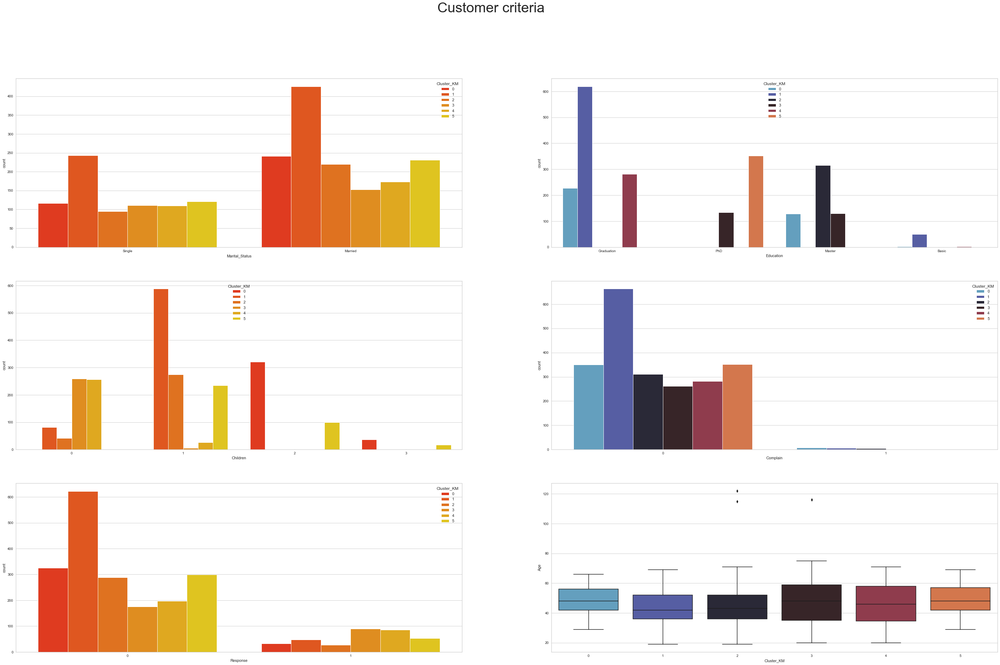

In [107]:
# Customer criteria (Categorical Data)

fig, axs = plt.subplots(3,2, figsize=(50,30))
plt.suptitle('Customer criteria', fontsize=40)
sns.set(font_scale=1)

ax1 = sns.countplot(data=data_fix,x='Marital_Status',palette='autumn', hue='Cluster_KM', dodge=True,  ax=axs[0,0])
ax2 = sns.countplot(data=data_fix,x='Education',palette='icefire',hue='Cluster_KM', dodge=True,  ax=axs[0,1])
ax3 = sns.countplot(data=data_fix,x='Children',palette='autumn',hue='Cluster_KM', dodge=True,  ax=axs[1,0])
ax4 = sns.countplot(data=data_fix,x='Complain',palette='icefire',hue='Cluster_KM', dodge=True,  ax=axs[1,1])
ax5 = sns.countplot(data=data_fix,x='Response',palette='autumn',hue='Cluster_KM', dodge=True,  ax=axs[2,0])
ax6 = sns.boxplot(x=data_fix['Cluster_KM'], y=data_fix['Age'], palette='icefire')

plt.show()

In [108]:
# Check for NaN

edu = data_fix.groupby(['Children', 'Cluster_KM']).size()
edu_plot = edu.reset_index().pivot(columns='Children', index='Cluster_KM', values=0)
edu_plot

Children,0,1,2,3
Cluster_KM,,,,
0,NaN,NaN,321.0,36.0
1,81.0,588.0,NaN,NaN
2,41.0,274.0,NaN,NaN
3,259.0,5.0,NaN,NaN
4,257.0,26.0,NaN,NaN
5,NaN,235.0,100.0,17.0


**Detail** :

1. Cluster 0
* Didominasi oleh Graduation
* Seluruh customer memiliki lebih dari 1 anak, didominasi oleh customer yang memiliki 2 anak

2. Cluster 1
* Didominasi oleh Graduation
* Seluruh customer memiliki kurang dari 2 anak, didominasi oleh customer yang memiliki 1 anak


3. Cluster 2
* Didominasi oleh Master
* Seluruh customer memiliki kurang dari 2 anak, didominasi oleh customer yang memiliki 1 anak


4. Cluster 3
* Didominasi oleh Master
* Seluruh customer memiliki kurang dari 2 anak, didominasi oleh customer yang tidak memiliki anak


5. Cluster 4
* Didominasi oleh Graduation
* Seluruh customer memiliki kurang dari 2 anak, didominasi oleh customer yang tidak memiliki anak


6. Cluster 5
* Didominasi oleh PhD
* Seluruh customer memiliki anak, didominasi oleh customer yang memiliki 1 anak

Seluruh cluster didominasi oleh customer dengan marital status menikah, tidak memiliki ketertarikan pada campaign terakhir, dan tidak memiliki komplain pada 2 tahun terakhir. Dari segi umur, Rentang umur pada masing-masing cluster sama yaitu mulai dewasa hingga lansia.

##### Income - Outcome in clustering

In [109]:
# Income

px.violin(data_fix, x="Cluster_KM", y="Income", color="Cluster_KM")

In [110]:
# Total Amount

px.box(data_fix, x="Cluster_KM", y="Total_Amount", color="Cluster_KM")

In [111]:
# Total Purchase

px.box(data_fix, x="Cluster_KM", y="Total_Purchase", color="Cluster_KM")

**Detail** :

1. Cluster 0
* Memiliki rata-rata income (43K), Total_Amount (96), Total_Purchase (6) kategori rendah

2. Cluster 1
* Memiliki rata-rata income (40K), Total_Amount (178), Total_Purchase (8)  kategori rendah

3. Cluster 2
* Memiliki rata-rata income (42K), Total_Amount (192), Total_Purchase (8)  kategori rendah

4. Cluster 3
* Memiliki rata-rata income (76K), Total_Amount (1315), Total_Purchase (19)  kategori tinggi

5. Cluster 4
* Memiliki rata-rata income (75K), Total_Amount (1376), Total_Purchase (19)  kategori tinggi

6. Cluster 5
* Memiliki rata-rata income (50K), Total_Amount (266), Total_Purchase (11)  kategori sedang


##### Promotion in clustering

<AxesSubplot:xlabel='Total_Camp', ylabel='count'>

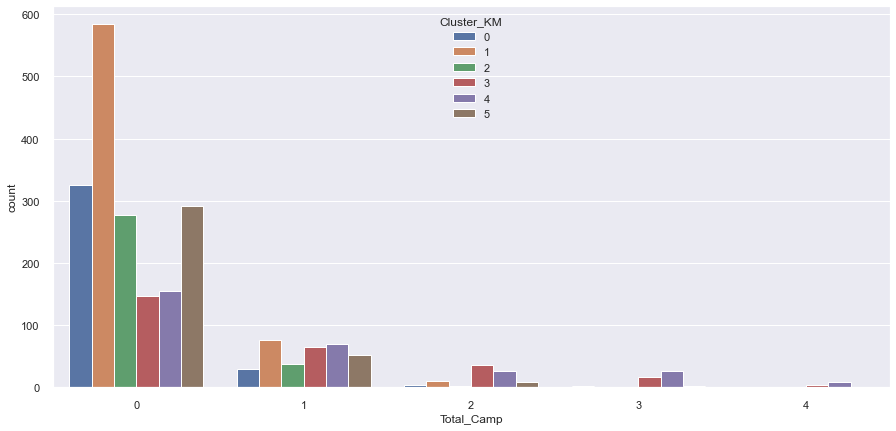

In [112]:
data_fixx = data_fix.copy()

data_fixx['Total_Camp'] = data_fixx["AcceptedCmp1"] + data_fixx["AcceptedCmp2"] + data_fixx["AcceptedCmp3"] + data_fixx["AcceptedCmp4"] + data_fixx["AcceptedCmp5"]
plt.figure(figsize=(15,7))
sns.countplot(x="Total_Camp", hue="Cluster_KM", data=data_fixx)

**Detail** :

Seluruh cluster didominasi oleh customer yang tidak terlalu tertarik dengan 5 campaign yang diadakan oleh market, hal ini ditunjukan dengan paling tingginya Total_Camp = 0 untuk seluruh cluster.

##### Purchase in clustering

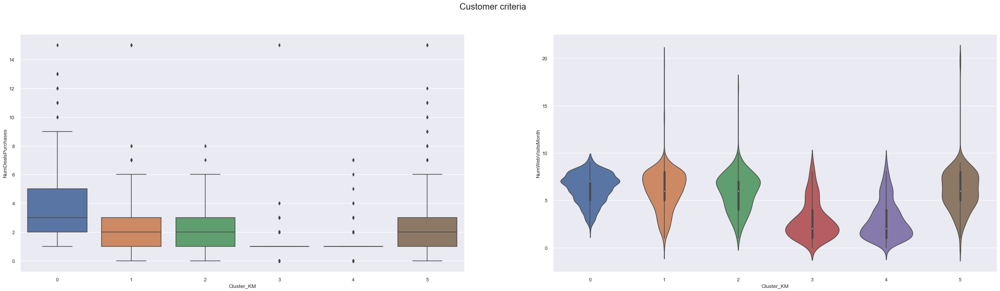

In [113]:
# Customer criteria based on puchases

fig, axs = plt.subplots(1,2, figsize=(40,10))
plt.suptitle('Customer criteria', fontsize=20)

ax1 = sns.boxplot(x="Cluster_KM", y="NumDealsPurchases", data=data_fix, ax=axs[0])
ax2 = sns.violinplot(x="Cluster_KM", y="NumWebVisitsMonth", data=data_fix, ax=axs[1])

plt.show()

In [114]:
# Menentukan media yang paling digemari customer (purchased) berdasarkan cluster   

Total_purchases = data_fixx[data_fixx['Total_Purchase'] > 0]
Purchase = ['NumWebPurchases','NumCatalogPurchases','NumStorePurchases']

def user_most_used_channel(Purchases: pd.Series):
    Purchase
    return Purchase[np.argmax(Purchases)]

Total_purchases['Purchase'] = Total_purchases[Purchase].apply(user_most_used_channel, axis=1).copy()
Total_purchases

,Education,Marital_Status,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Total_Amount,Total_Purchase,Cluster_KM,Total_Camp,Purchase
0,Graduation,Single,58138.0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,58,0,1617,22,4,0,NumCatalogPurchases
1,Graduation,Single,46344.0,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,61,2,27,4,0,0,NumStorePurchases
2,Graduation,Married,71613.0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,50,0,776,20,4,0,NumStorePurchases
3,Graduation,Married,26646.0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,31,1,53,6,1,0,NumStorePurchases
4,PhD,Married,58293.0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,34,1,422,14,5,0,NumStorePurchases
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,Graduation,Married,61223.0,46,709,43,182,42,118,247,2,9,3,4,5,0,0,0,0,0,0,0,48,1,1341,16,1,0,NumWebPurchases
2236,PhD,Married,64014.0,56,406,0,30,0,0,8,7,8,2,5,7,0,0,0,1,0,0,0,69,3,444,15,5,1,NumWebPurchases
2237,Graduation,Single,56981.0,91,908,48,217,32,12,24,1,2,3,13,6,0,1,0,0,0,0,0,34,0,1241,18,4,1,NumStorePurchases
2238,Master,Married,69245.0,8,428,30,214,80,30,61,2,6,5,10,3,0,0,0,0,0,0,0,59,1,843,21,2,0,NumStorePurchases


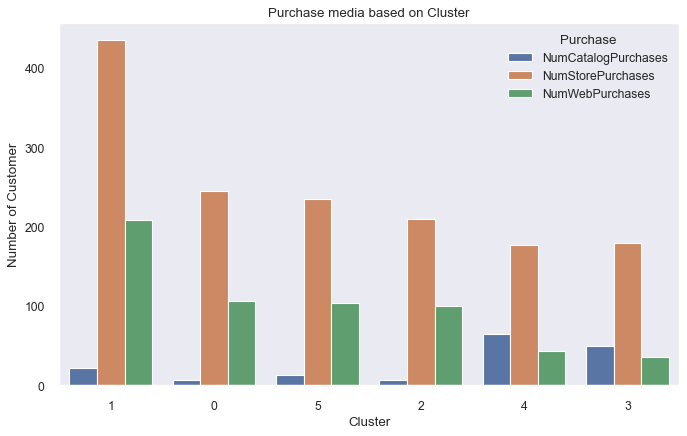

In [115]:

plt.figure(figsize=(10, 6), dpi=80)
sns.countplot(
    x="Cluster_KM", data=Total_purchases, hue="Purchase",
    order=Total_purchases.Cluster_KM.value_counts().index
)
plt.grid(False)
plt.xlabel("Cluster")
plt.ylabel("Number of Customer")
plt.title("Purchase media based on Cluster")
plt.show()

**Detail** :

1. Cluster 0
* Didominasi oleh customer dengan penggunaan discount cukup tinggi
* Didominasi oleh customer dengan kunjungan website cukup tinggi

2. Cluster 1
* Didominasi oleh customer dengan penggunaan discount sedang
* Didominasi oleh customer dengan kunjungan website sedang

3. Cluster 2
* Didominasi oleh customer dengan penggunaan discount sedang
* Didominasi oleh customer dengan kunjungan website sedang

4. Cluster 3
* Didominasi oleh customer dengan penggunaan discount rendah
* Didominasi oleh customer dengan kunjungan website rendah

5. Cluster 4
* Didominasi oleh customer dengan penggunaan discount rendah
* Didominasi oleh customer dengan kunjungan website rendah

6. Cluster 5
* Didominasi oleh customer dengan penggunaan discount sedang
* Didominasi oleh customer dengan kunjungan website sedang

Banyak customer pada setiap cluster yang memiliki minat berbelanja melalui store dibandingkan dengan berbelanja melalui katalog atau website. Hal ini ditunjukan dengan frekuensi terbesar pada masing-masing cluster ada di Numstore Purchase

##### Product in clustering

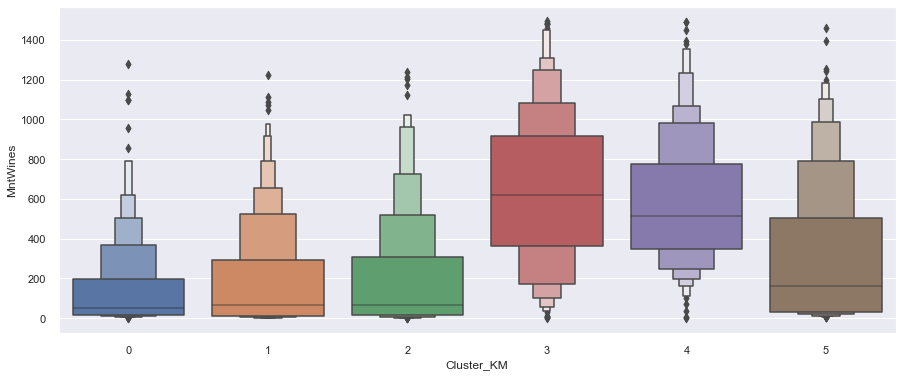

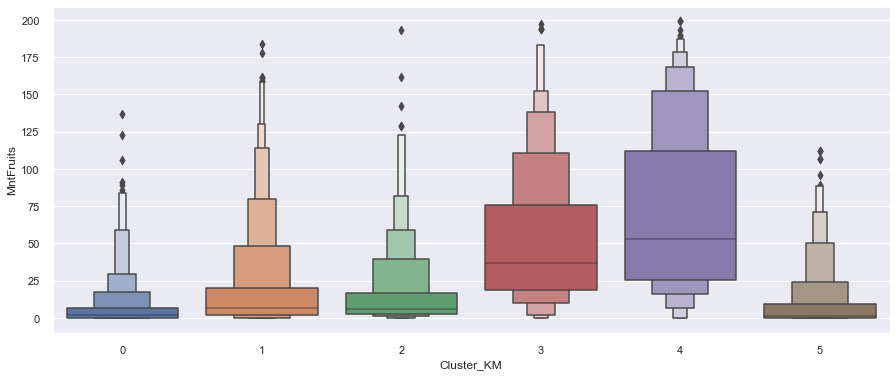

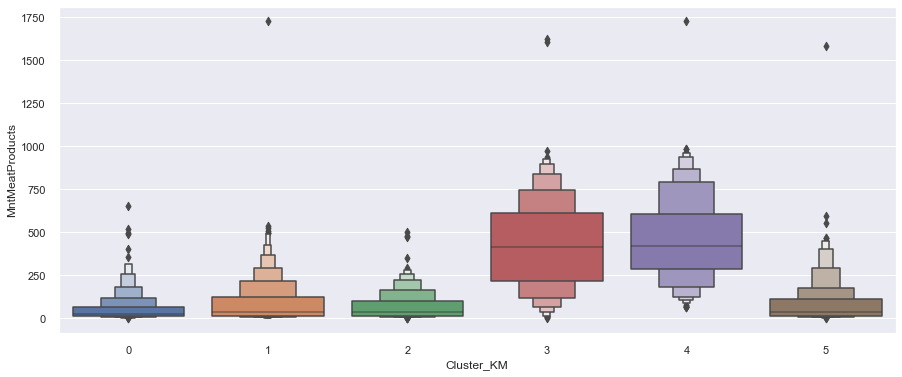

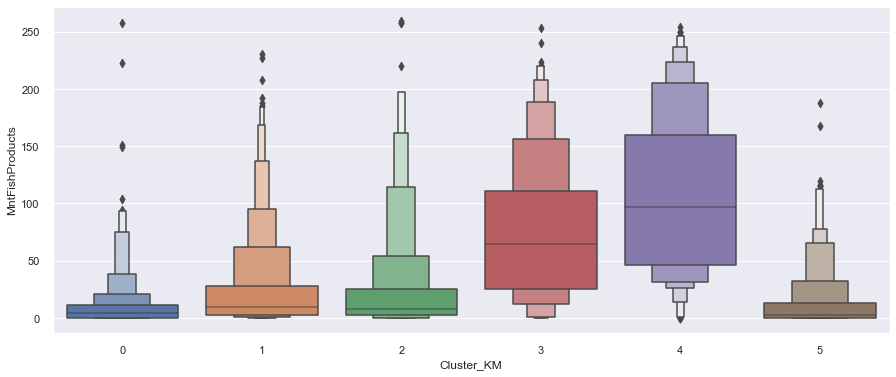

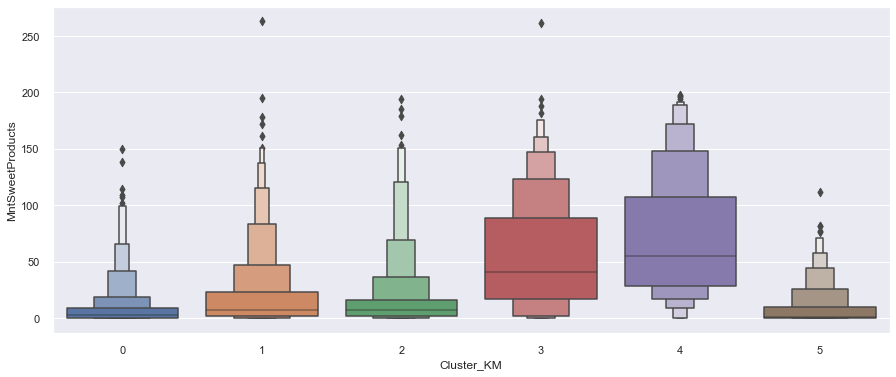

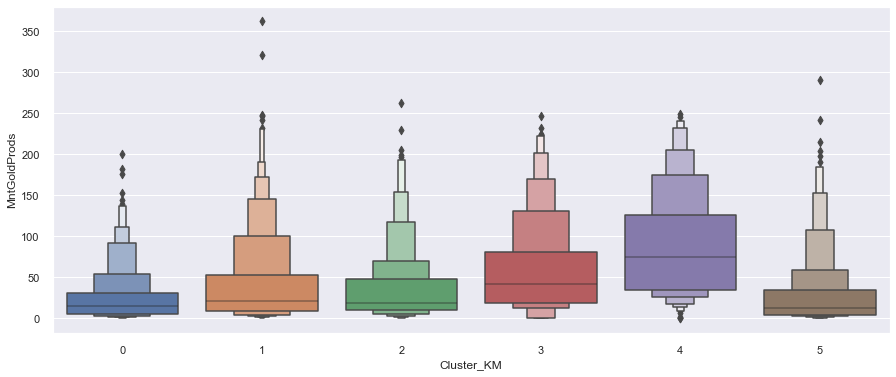

In [116]:
prod = ['MntWines', 'MntFruits','MntMeatProducts', 'MntFishProducts',
                           'MntSweetProducts', 'MntGoldProds']
for i in prod:
    plt.figure(figsize=(15,6))
    sns.boxenplot(x="Cluster_KM", y=i,data=data_fix)


In [117]:
# Check for Sum

sum = data_fix.groupby('Cluster_KM').sum()
sum

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Children,Total_Amount,Total_Purchase
Cluster_KM,,,,,,,,,,,,,,,,,,,,,,,,
0,15819448.5,18211,50822,3070,19491,4230,3419,9034,1307,1132,401,1550,2257,15,15,2,5,0,7,32,17372,750,90066,3083
1,29139436.5,32979,126064,12877,57922,16634,13543,27982,1552,2562,1193,3375,4057,48,34,2,7,3,6,47,29044,588,255022,7130
2,13760073.5,14552,62543,5259,22285,8039,5541,11199,717,1199,521,1619,1848,21,15,2,2,1,4,27,14005,274,114866,3339
3,19409397.0,12709,169824,13850,113252,20119,14648,15699,302,1305,1460,2134,777,25,40,71,51,7,2,89,12664,5,347392,4899
4,21307596.5,14539,163049,20248,131594,30365,20302,24943,335,1473,1660,2351,829,24,38,82,71,13,1,86,13034,26,390501,5484
5,17577113.0,17015,108514,3613,29424,4670,3168,9752,995,1479,728,1941,2141,30,25,4,8,6,1,53,17356,486,159141,4148


**Detail** :

1. Cluster 0
* Customer dengan intensitas belanja rendah, namun memiliki ketertarikan pada produk Wines paling rendah dari cluster lainnya

2. Cluster 1
* Customer dengan intensitas belanja sedang, namun memiliki ketertarikan pada produk Wines cukup tinggi dari cluster lainnya

3. Cluster 2
* Customer dengan intensitas belanja sedang, namun memiliki ketertarikan pada produk Wines cukup tinggi dari cluster lainnya

4. Cluster 3
* Customer dengan intensitas belanja tinggi, memiliki ketertarikan pada produk Wines tertinggi dari cluster lainnya

5. Cluster 4
* Customer dengan intensitas belanja tinggi, namun memiliki ketertarikan pada produk Wines sangat tinggi dari cluster lainnya
* Cluster yang paling banyak melakukan pembelian Produk apapun


6. Cluster 5
* Customer dengan intensitas belanja rendah, namun memiliki ketertarikan pada produk Wines cukup tinggi dari cluster lainnya

#### Summary



1. Cluster 0 (Ini adalah kelompok berpenghasilan rendah yang memiliki banyak tanggungan. Kunjungan web mereka tinggi. Mereka suka membeli dengan discount walaupun intensitas belanjanya rendah.)

* Didominasi oleh Graduation
* Seluruh customer memiliki lebih dari 1 anak, didominasi oleh customer yang memiliki 2 anak
* Memiliki rata-rata income dan outcome kategori rendah
* Didominasi oleh customer dengan penggunaan discount cukup tinggi
* Didominasi oleh customer dengan kunjungan website cukup tinggi
* Customer dengan intensitas belanja rendah, namun memiliki ketertarikan pada produk Wines paling rendah dari cluster lainnya

2. Cluster 1 (Kelompok berpenghasilan rendah ini memiliki anak tidak terlalu banyak. Preferensi pembelian mereka dengan diskon tidak terlalu besar dan intensitas belanjanya juga sedang.)

* Didominasi oleh Graduation
* Seluruh customer memiliki kurang dari 2 anak, didominasi oleh customer yang memiliki 1 anak
* Memiliki rata-rata income dan outcome  kategori rendah
* Didominasi oleh customer dengan penggunaan discount sedang
* Didominasi oleh customer dengan kunjungan website sedang
* Customer dengan intensitas belanja sedang, namun memiliki ketertarikan pada produk Wines cukup tinggi dari cluster lainnya

3. Cluster 2 (Kelompok berpenghasilan rendah ini memiliki anak tidak terlalu banyak. Preferensi pembelian mereka dengan diskon tidak terlalu besar dan intensitas belanjanya juga sedang.)

* Didominasi oleh Master
* Seluruh customer memiliki kurang dari 2 anak, didominasi oleh customer yang memiliki 1 anak
* Memiliki rata-rata income dan outcome kategori rendah
* Didominasi oleh customer dengan penggunaan discount sedang
* Didominasi oleh customer dengan kunjungan website sedang
* Customer dengan intensitas belanja sedang, namun memiliki ketertarikan pada produk Wines cukup tinggi dari cluster lainnya

4. Cluster 3 (Kelompok dengan pendapatan rata-rata tertinggi, tanpa anak, intensitas belanja tinggi dengan menghabiskan paling banyak untuk Anggur. Interaksi Web termasuk rendah. Diskon juga tidak disukai.)

* Didominasi oleh Master
* Seluruh customer memiliki kurang dari 2 anak, didominasi oleh customer yang tidak memiliki anak
* Memiliki rata-rata income dan outcome kategori tinggi
* Didominasi oleh customer dengan penggunaan discount rendah
* Didominasi oleh customer dengan kunjungan website rendah
* Customer dengan intensitas belanja tinggi, memiliki ketertarikan pada produk Wines tertinggi dari cluster lainnya

5. Cluster 4 (Kelompok dengan pendapatan rata-rata tinggi, tanpa anak, intensitas belanja tinggi dengan menghabiskan paling banyak untuk Anggur. Interaksi Web termasuk rendah. Diskon juga tidak disukai. Kelompok ini memiliki pembelian seluruh prosuk paling banyak)

* Didominasi oleh Graduation
* Seluruh customer memiliki kurang dari 2 anak, didominasi oleh customer yang tidak memiliki anak
* Memiliki rata-rata income dan outcome kategori tinggi
* Didominasi oleh customer dengan penggunaan discount rendah
* Didominasi oleh customer dengan kunjungan website rendah
* Customer dengan intensitas belanja tinggi, namun memiliki ketertarikan pada produk Wines sangat tinggi dari cluster lainnya
* Cluster yang paling banyak melakukan pembelian Produk apapun


6. Cluster 5 (Ini adalah kelompok berpenghasilan sedang dan satu-satunya yang mencakup banyak individu dengan pendidikan PhD.Interaksi Web termasuk sedang. Diskon juga lumayan disukai. namun memiliki ketertarikan terhadap anggur cukup tinggi)

* Didominasi oleh PhD
* Seluruh customer memiliki anak, didominasi oleh customer yang memiliki 1 anak
* Memiliki rata-rata income dan outcome kategori sedang
* Didominasi oleh customer dengan penggunaan discount sedang
* Didominasi oleh customer dengan kunjungan website sedang
* Customer dengan intensitas belanja rendah, namun memiliki ketertarikan pada produk Wines cukup tinggi dari cluster lainnya